# Devanagari Handwritten Characters Recognition- Image Segmentation Using NumPy


## Introduction
This is the part where most of my efforts were used. Image Segmentation using NumPy sounds stupid idea but it actually is very interesting to work on. So here on this blog i will try to make a segmentation faster and easier than the previous project also i will try to make this OOP styled.

## Dummy Image
Go to paint and draw a text just like below or for the best practice download the image below.
![image-title-here](assets/magana.png)
On above image, there are some noises added for the test case. Our target is to make a OCR that can work with some background noises also.

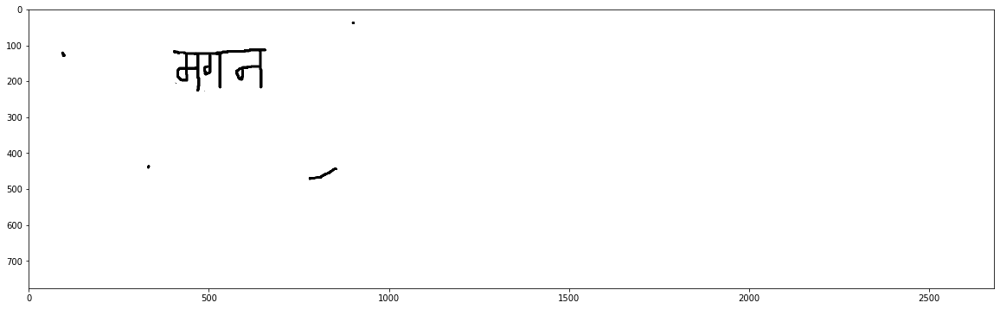

In [100]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import time
import warnings
warnings.filterwarnings("ignore")

img = cv2.imread("Assets/magana.png", 0)

def show(img, figsize=(20, 20)):
    fig = plt.figure(figsize=figsize)
    plt.imshow(img, cmap="gray")
    plt.show()
show(img)

## Crop An Image
As seeing on above image, it is clear that the real text lies on some portion of the entire image and most part of the image is background. SO we have to crop a image part where text lies. The idea is simple. 
1. Define some variables like how many of pixels will be considered as noise. On above case there are dots and a small line too. How can we define a variable that can eliminate both noises?
2. Lets say for some case 9.2% of total rows will be noise. What will be noise? Any texture that has rows less than or equal to 9.2% of total rows is a noise. 
3. Make an array which have single row and column equal to image's. Let its values be background color.
4. for each row of image (from top):
    * If current row is equal to array with background color then increase our count.
    * Else  make count 0.
    * If count is greater or equal to check value then the texture we found `check` step ago is not noise so break from the loop because we found a top part of text.
5. for each row of image (from bottom to top):
    * If current row is equal to array with background color then increase our count.
    * Else  make count 0.
    * If count is greater or equal to check value then the texture we found `check` step ago is not noise so break from the loop because we found a bottom part of text.
6. Follow step 4 and 5 to find the left and right part of the text.

### See the demo
The code below shows the result.

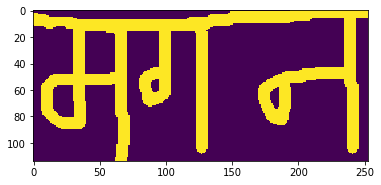

In [101]:
def borders(here_img, thresh, bthresh=0.092):
    shape = here_img.shape
    #check = int(115 * size[0] / 600)
    #check = int(55 * size[0] / 600)
    check= int(bthresh*shape[0])
    image = here_img[:]
    top, bottom = 0, shape[0] - 1
    #plt.imshow(image)
    #plt.show()
    

    #find the background color for empty column
    bg = np.repeat(thresh, shape[1])
    count = 0
    for row in range(1, shape[0]):
        if  (np.equal(bg, image[row]).any()) == True:
            #print(count)
            count += 1
        else:
            count = 0
        if count >= check:
            top = row - check
            break
    

    bg = np.repeat(thresh, shape[1])
    count = 0
    rows = np.arange(1, shape[0])
    #print(rows)
    for row in rows[::-1]:
        if  (np.equal(bg, image[row]).any()) == True:
            count += 1
        else:
            count = 0
        if count >= check:
            bottom = row + count
            break

    d1 = (top - 2) >= 0 
    d2 = (bottom + 2) < shape[0]
    d = d1 and d2
    if(d):
        b = 2
    else:
        b = 0
    
    return (top, bottom, b)


def preprocess(bgr_img):#gray image   
    blur = cv2.GaussianBlur(bgr_img,(5,5),0)
    ret,th_img = cv2.threshold(blur,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU) #converts black to white and inverse

    rows, cols = th_img.shape
    bg_test = np.array([th_img[i][i] for i in range(5)])
    if bg_test.all() == 0:
        text_color = 255
    else:
        text_color = 0
    
    tb = borders(th_img, text_color)
    lr = borders(th_img.T, text_color)
    dummy = int(np.average((tb[2], lr[2]))) + 2
    template = th_img[tb[0]+dummy:tb[1]-dummy, lr[0]+dummy:lr[1]-dummy]
    
    plt.imshow(template)
    plt.show()
    return (template, tb, lr)
prepimg, tb, lr = preprocess(img)

**Notes**
* The thresholding of an image is most important part because we have to get pure black and white image so that tasks like segmentation becomes easier.
* The value `bthresh` on above function is defined by experimenting with different examples. Our goal is to find the best vlaue which can eliminate as many noise as possible.
* The *problem* here is that if two consecutive noises on different places appears then this algorithm fails.
* The background color of image is taken by checking 5 pixels from top left of the image. This approach works for the most of the time but is not a best one.
* The variable `dummy` is taken so that we can take little bit of space around the text.

## Segmentation
The segmentation of an image can be done by the same idea given above but problem rises when we are working with characters like ग.
1. Define some variables like threshold bg color, minimum length of segment, how many % of the portion should be eliminated as top part, how many % of space is allowed between two characters etc.
2. Tilt an image, ie. translate.
3. Make an list `bg_keys` where we store all the row, for which the value is equal to background color.
4. Scan from top to bottom.
    * If current row is equal to background color then append this row i.e row number not the value.
5. Make a new list `new_keys`, where we add the first row and last row from the list `bg_keys`.
6. Scan for each value on list `new_keys`.
    * If the difference between current value and next value is greater or equal than the value that we defined as space. i.e on 1st step.
        * If it is then append current value to `new_list`.
7. Sort the values inside list `new_list`.
8. Scan for false segments i.e segement whose length is small then defined value and eliminate these segments.
9. Finally, take these final segmenting column values and crop the part of image from the image that was given here. i.e. cropped image.
10. Return these image segments.

### See the Demo

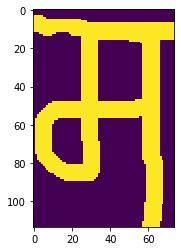

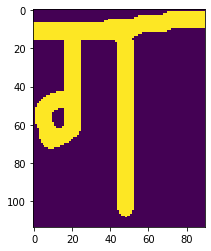

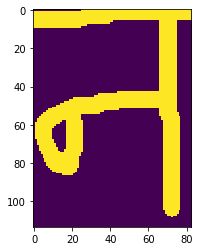

In [102]:
def segmentation(bordered, thresh=255, min_seg=10, scheck=0.15):
    try:
        shape = bordered.shape
        check = int(scheck * shape[0])
        image = bordered[:]
        image = image[check:].T
        shape = image.shape
        #plt.imshow(image)
        #plt.show()

        #find the background color for empty column
        bg = np.repeat(255 - thresh, shape[1])
        bg_keys = []
        for row in range(1, shape[0]):
            if  (np.equal(bg, image[row]).all()):
                bg_keys.append(row)            

        lenkeys = len(bg_keys)-1
        new_keys = [bg_keys[1], bg_keys[-1]]
        #print(lenkeys)
        for i in range(1, lenkeys):
            if (bg_keys[i+1] - bg_keys[i]) > check:
                new_keys.append(bg_keys[i])
                #print(i)

        new_keys = sorted(new_keys)
        #print(new_keys)
        segmented_templates = []
        first = 0
        bounding_boxes = []
        for key in new_keys[1:]:
            segment = bordered.T[first:key]
            if segment.shape[0]>=min_seg and segment.shape[1]>=min_seg:
                segmented_templates.append(segment.T)
                bounding_boxes.append((first, key))
            first = key
        
        last_segment = bordered.T[new_keys[-1]:]
        if last_segment.shape[0]>=min_seg and last_segment.shape[1]>=min_seg:
            segmented_templates.append(last_segment.T)
            bounding_boxes.append((new_keys[-1], new_keys[-1]+last_segment.shape[0]))


        return(segmented_templates, bounding_boxes)
    except:
        return [bordered, (0, bordered.shape[1])]
segments=segmentation(prepimg)
for simg in segments[0]:
    plt.imshow(simg)
    plt.show()

So far so good. I encourage you to try other images also and if you can not find the best segments, then always try to tune the values before editing the code.

## Localize Text
Now we have found a segments of our image and we also have cropped our image to find only text part but now we have to draw a rectangle or bounding box around them. How can we do that? The problem we currently have is, we have segmented a cropped image and we must show the segments on real image, how can we do that? I tried to do the template matching on original image. Which is time consuming plus sometimes false rectangle is drawn but what we can do is draw a rectangle around a segments by using the segmenting columns and top/bottom, left/right values.

Below is a working pseudo-code to do localization. 
1. Take a original image, top/bottom, left/right and segments values.
2. Make a copy of original image and make an empty list `boxes` to store all boxes.
3. Loop through every segmenting values:
    * Append (top, bottom, left, right) to `boxes`.
4. Draw rectangles and return drawn image and `boxes`.

[(104, 236, 405, 479), (104, 236, 479, 569), (104, 236, 569, 652)]


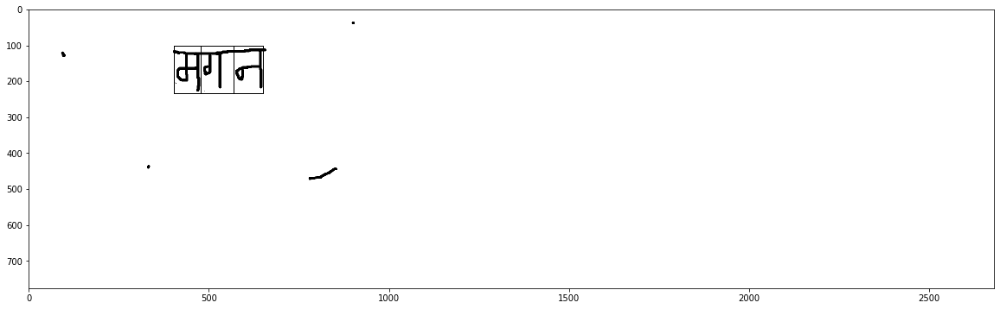

In [103]:
def localize(orig_img, tb, lr, segments):
    d=5
    rimg = orig_img.copy()
    boxes = []
    for simg, bb in zip(segments[0], segments[1]):
        bb = np.array(bb)
        bb += lr[0]
        # draw rows
        rimg[tb[0]-d:tb[0], bb[0]-d:bb[1]+d] = 0
        rimg[tb[1]:tb[1]+d, bb[0]-d:bb[1]+d] = 0

        # draw cols
        rimg[tb[0]-d:tb[1]+d, bb[0]-d:bb[0]+d] = 0
        rimg[tb[0]-d:tb[1]+d, bb[1]-d:bb[1]+d] = 0
        
        boxes.append((tb[0]-d, tb[1]+d, bb[0], bb[1]))
        #show(rimg)
    rimg = img.copy()
    print(boxes)
    for box in boxes:
        t, b, l, r = box
        cv2.rectangle(rimg, (l, t), (r, b), (0, 0, 0), 2)
    show(rimg)    
    return rimg, boxes
localized = localize(img, tb, lr, segments)

Now we have found a segments on entire image. We have also found a better way of localizing image. Now is the time to pass each segments to classifier. 

## Classification
Resize an image segment and then pass it to the classifier. As doing this step, you might find the classification false but don't panic because the best option will be to train your model for bit more. 
1. Read the json file.
2. Load a model and load weights.
3. Make labels.
4. Return accuracy and label.

In [104]:
import numpy as np
from tensorflow.keras.models import model_from_json
from tensorflow.keras.models import load_model

def prediction(img):
    # load json and create model
    json_file = open('cnn\cnn.json', 'r')
    
    loaded_model_json = json_file.read()
    json_file.close()
    loaded_model = model_from_json(loaded_model_json)
    
    # load weights into new model
    loaded_model.load_weights("cnn\cnn.h5")
    #print("Loaded model from disk")
    
    loaded_model.save('cnn.hdf5')
    loaded_model=load_model('cnn.hdf5')
    
    characters = '०,१,२,३,४,५,६,७,८,९,क,ख,ग,घ,ङ,च,छ,ज,झ,ञ,ट,ठ,ड,ढ,ण,त,थ,द,ध,न,प,फ,ब,भ,म,य,र,ल,व,श,ष,स,ह,क्ष,त्र,ज्ञ'
    characters = characters.split(',')
    
    x = np.asarray(img, dtype = np.float32).reshape(1, 32, 32, 1) / 255 
    
    output = loaded_model.predict(x)
    output = output.reshape(46)
    predicted = np.argmax(output)
    devanagari_label = characters[predicted]
    success = output[predicted] * 100
    
    return devanagari_label, success


1. Now take each segemts, resize it to model input shape.
2. Add some blur and erode it. Eroding will make our image more bold in this case.
3. Pass to prediction.
4. Return prediction label and accuracy.

In [105]:
def classifier(segments):
    pred_lbl = ""
    acc = []
    for segment in segments:
        segment = cv2.resize(segment, (32, 32))
        segment = cv2.GaussianBlur(segment, (3, 3), 0)
        segment = cv2.erode(segment, (3, 3), 1)
        #show(segment)
        
        lbl, a = prediction(segment)
        pred_lbl+=lbl
        acc.append(a)
    return pred_lbl, np.array(acc).mean()
classifier(segments[0])

('मगन', 98.80913893381755)

Now most of methods are done well. Now is the time to wrap our all methods inside a class.

## Class: Devanagari Handwritten Character OCR
I am not going to explain much about this class because i have already explained most of the methods above. But i have modified some methods and added some other methods too. I encourage you to look from the `main` method.

Image not found now turning to video mode.

Click spacebar for photo and anything else for video.



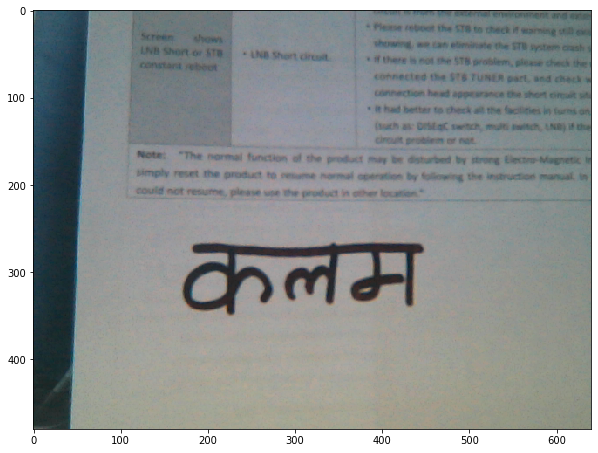

('झम', 97.71469533443451)


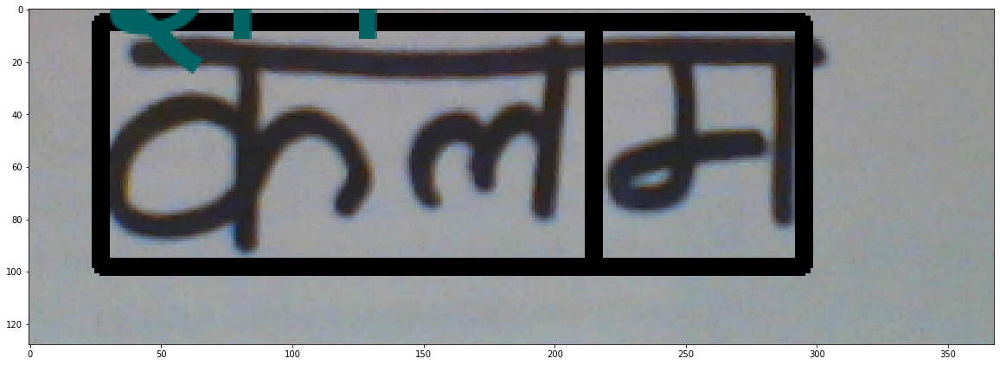

In 13.915601 sec


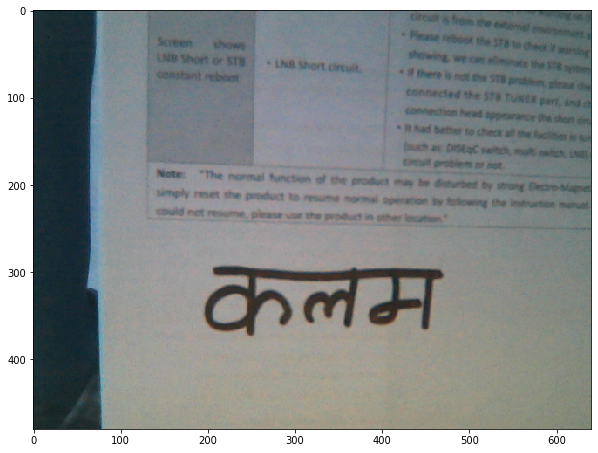

('झ', 96.50164246559143)


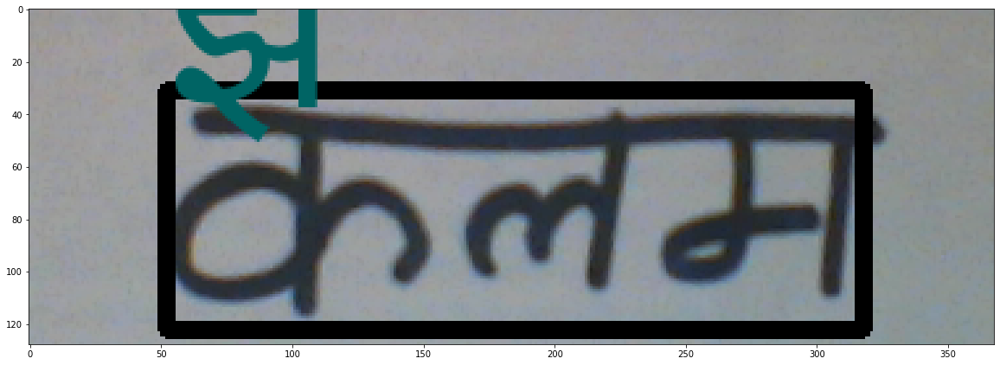

In 1.134997 sec


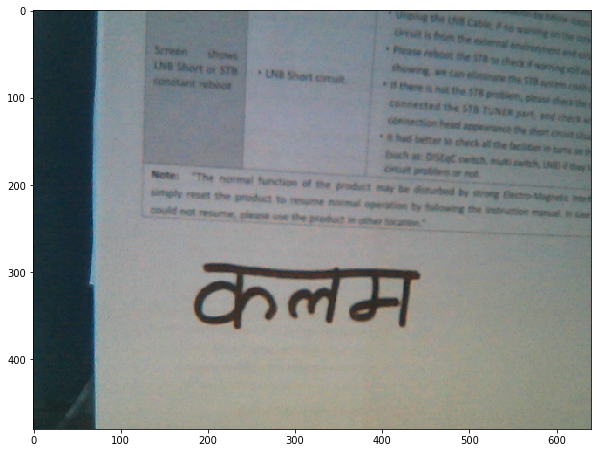

('झ', 79.04990911483765)


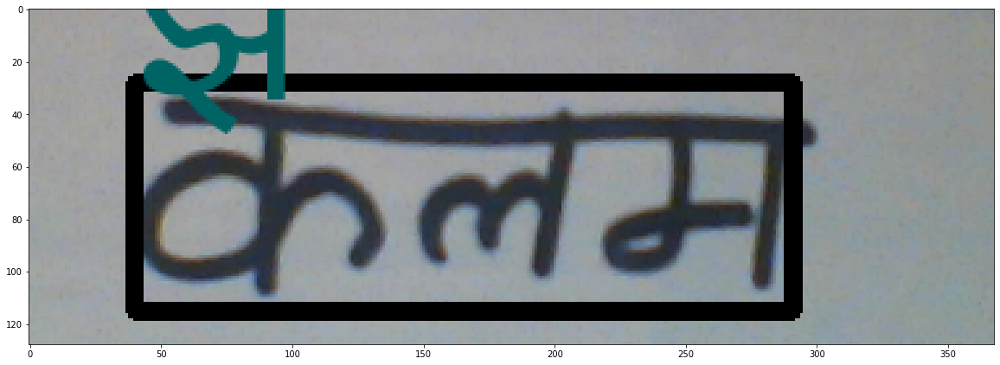

In 1.141986 sec


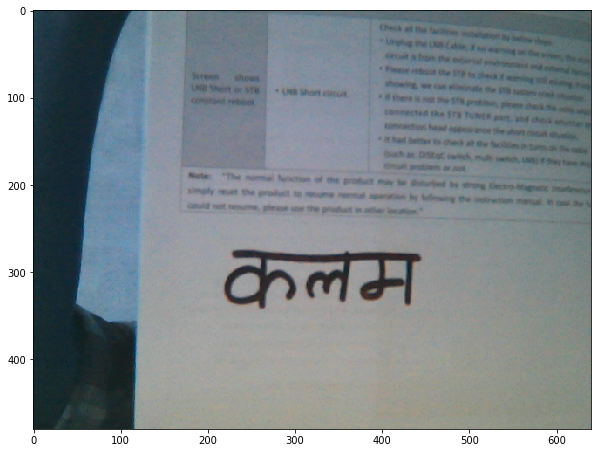

('झम', 99.90800023078918)


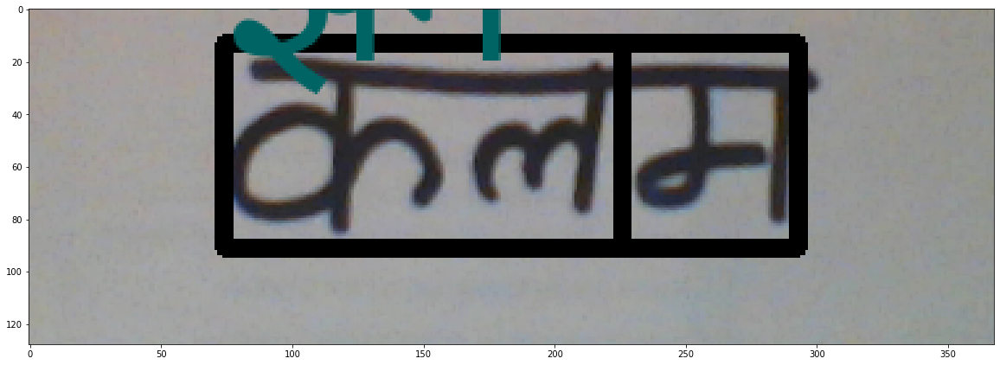

In 1.148003 sec


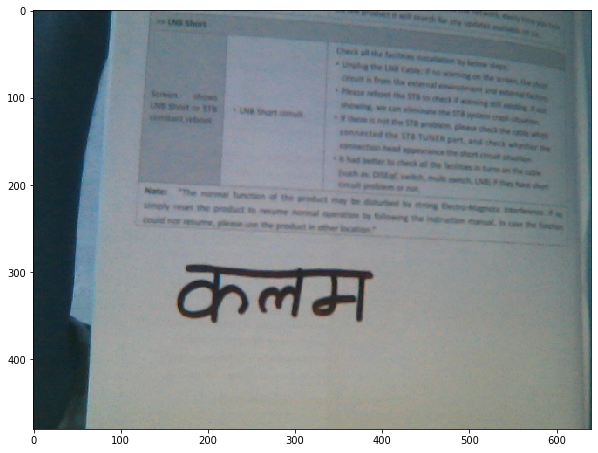

('झ', 80.02747297286987)


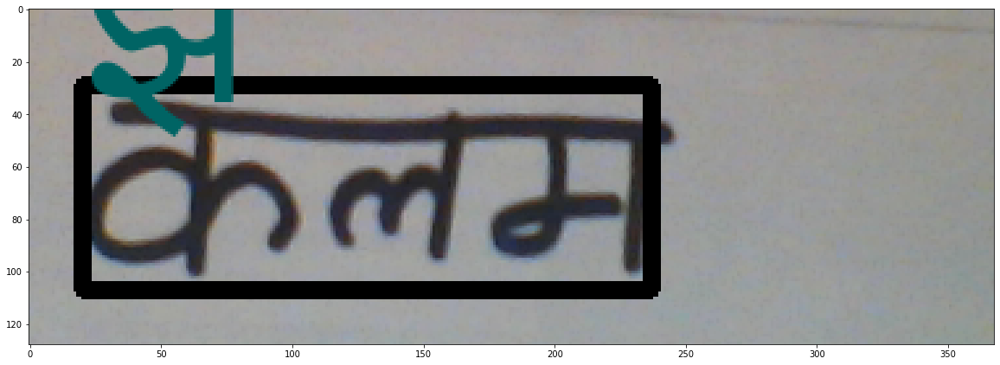

In 1.151988 sec


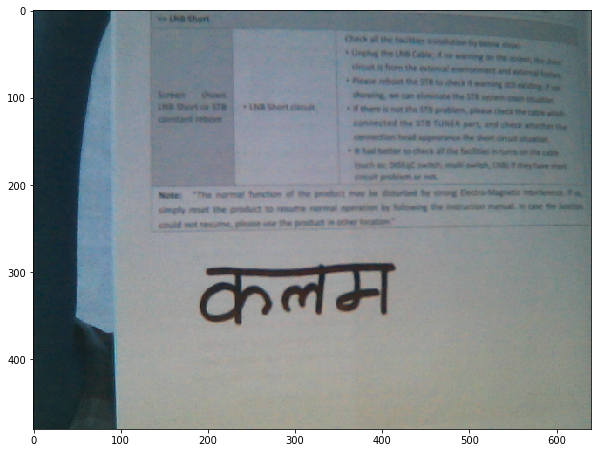

('झम', 99.62161779403687)


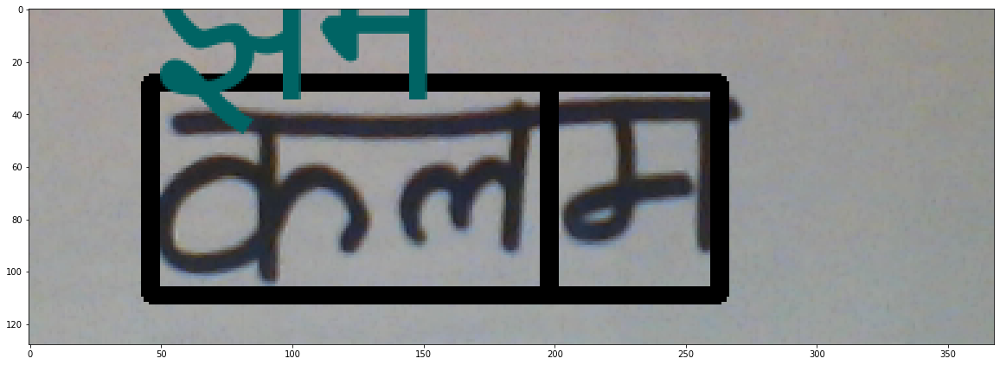

In 1.266996 sec


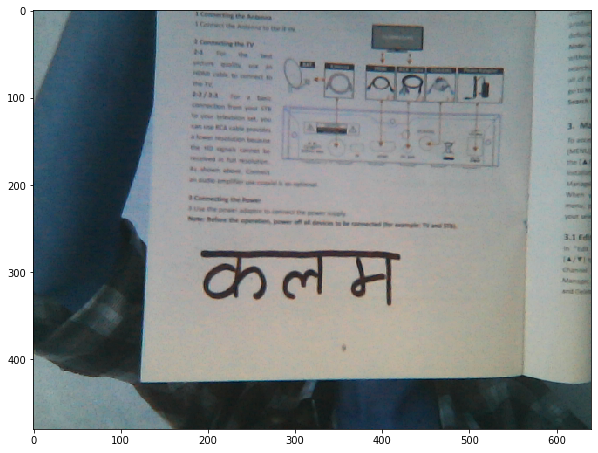

('कलम', 99.99161561330159)


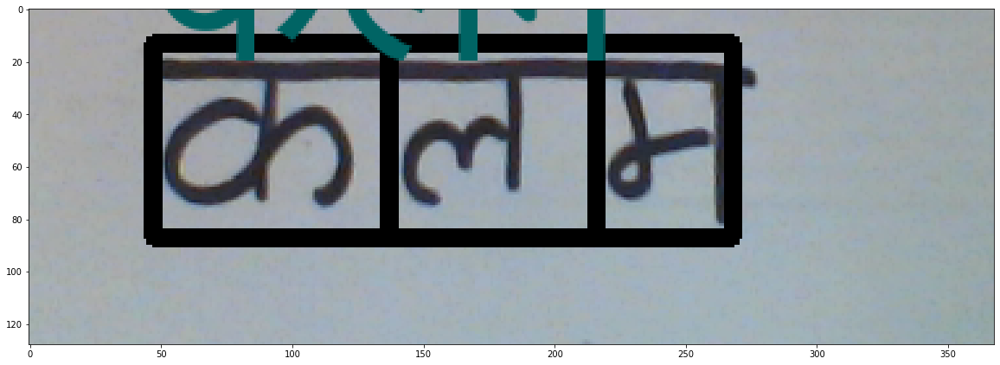

In 1.159993 sec


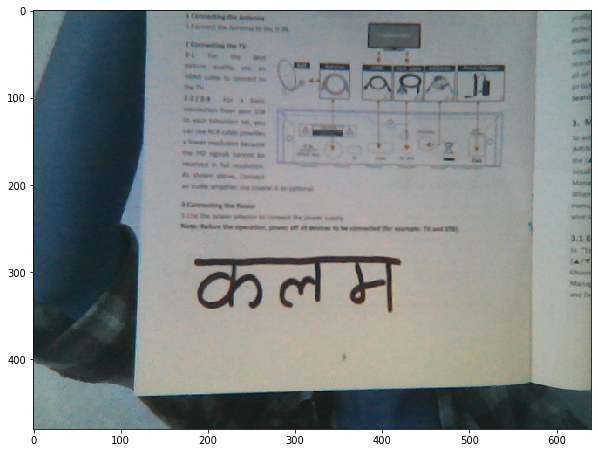

('कलम', 99.90773598353069)


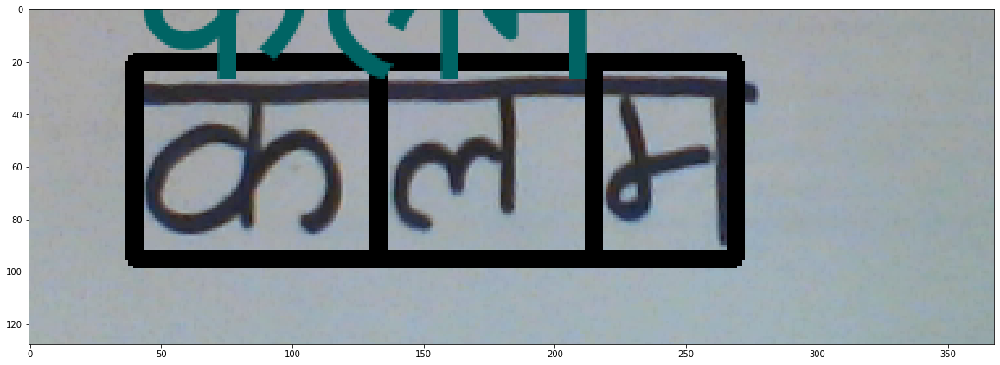

In 1.197987 sec


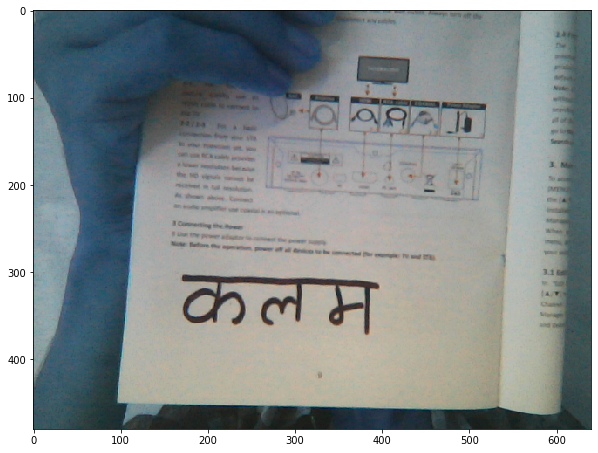

('कलम', 99.9933123588562)


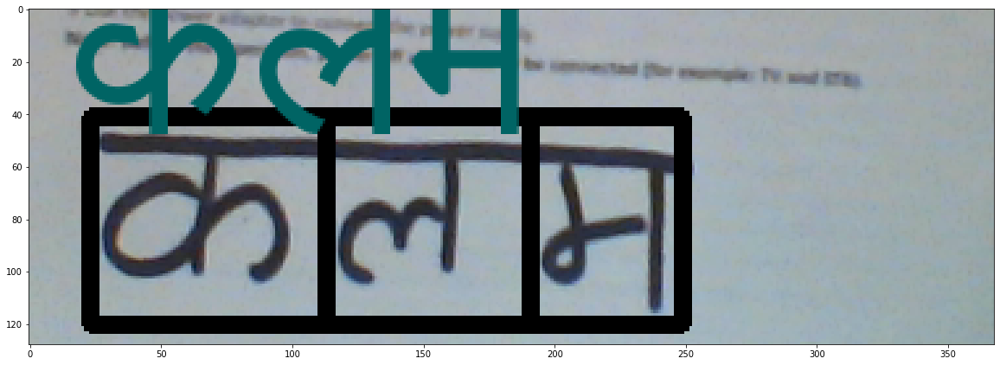

In 1.168993 sec


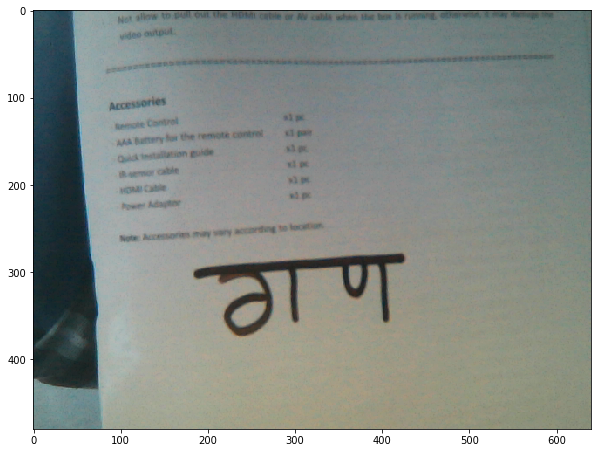

('भग', 52.09280699491501)


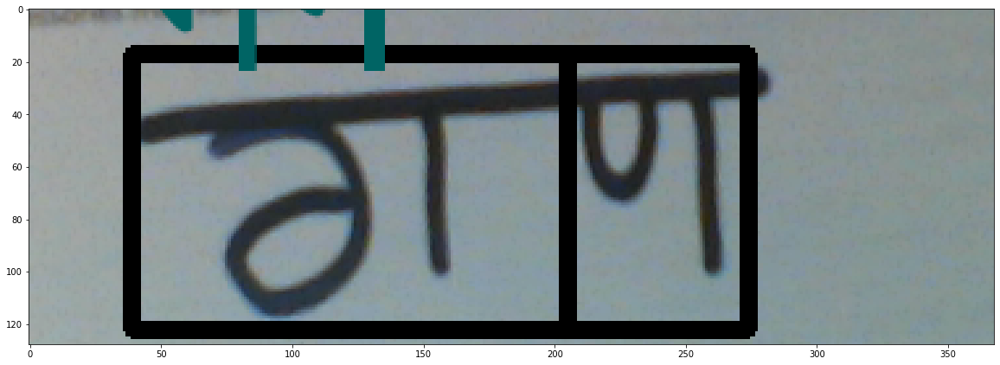

In 1.155990 sec


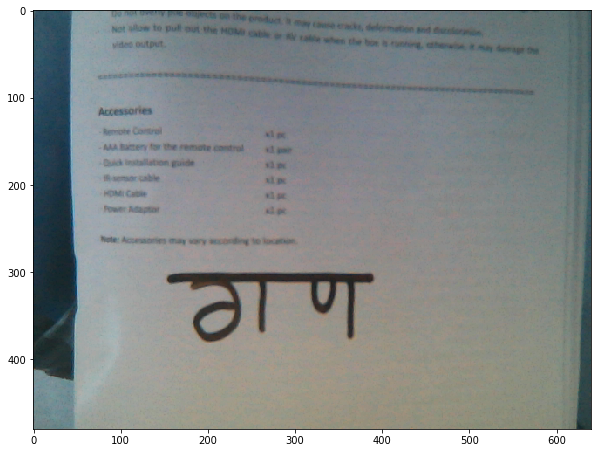

('८गग', 72.0995565255483)


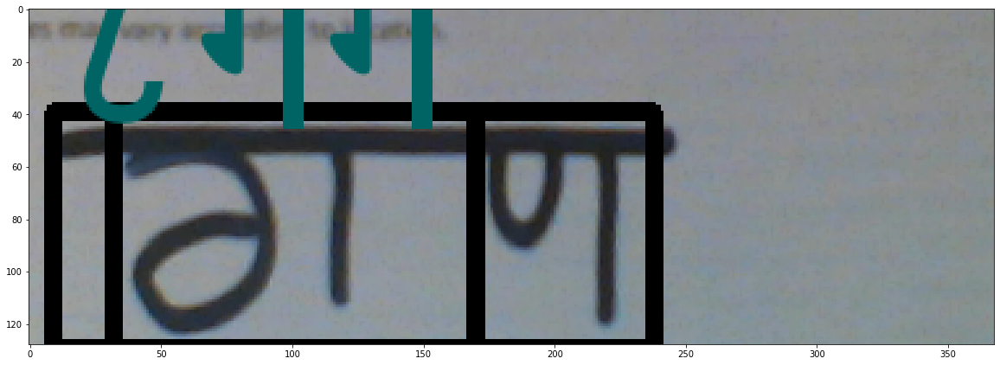

In 1.155998 sec


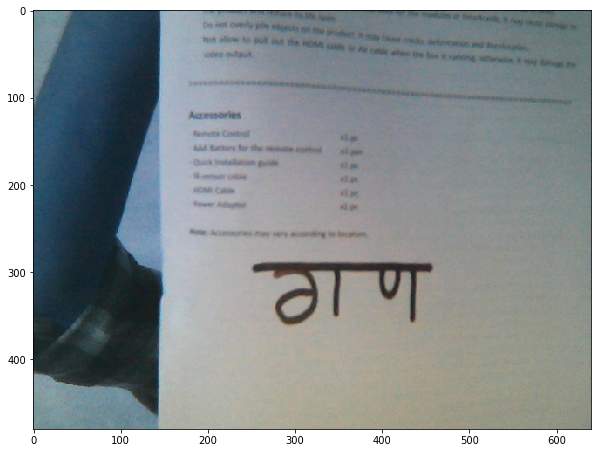

('८तपग', 62.62888312339783)


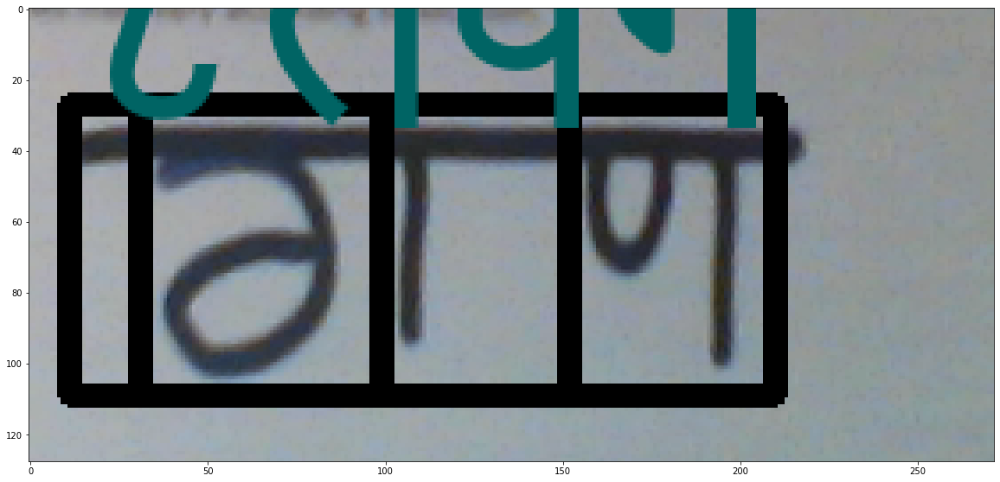

In 1.209999 sec


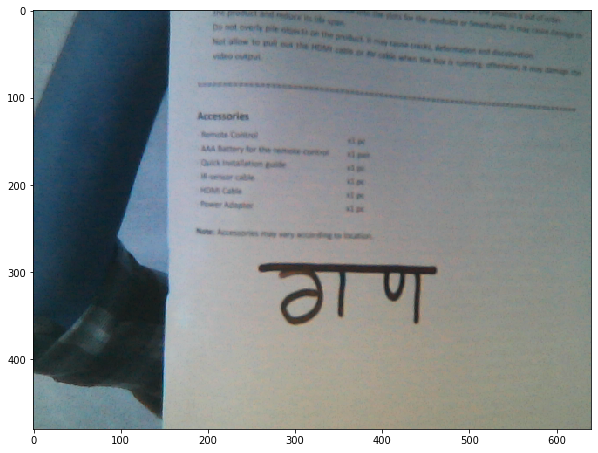

('८त८ण', 62.33949661254883)


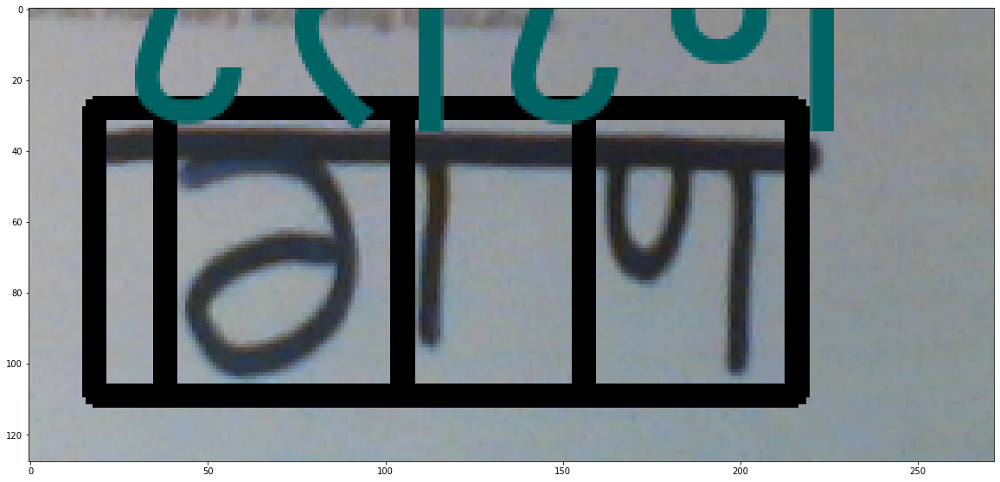

In 1.196995 sec


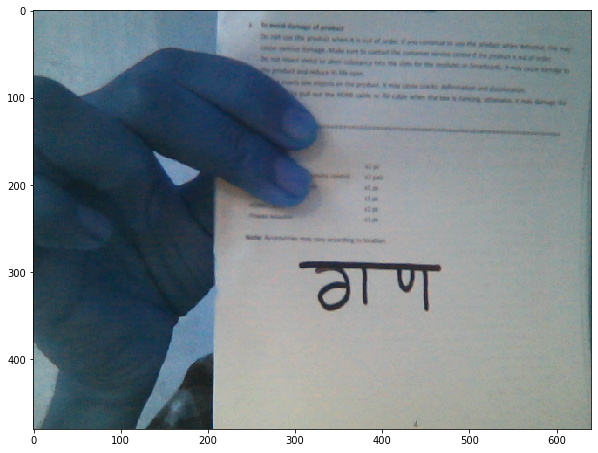

('८तपण', 72.17062413692474)


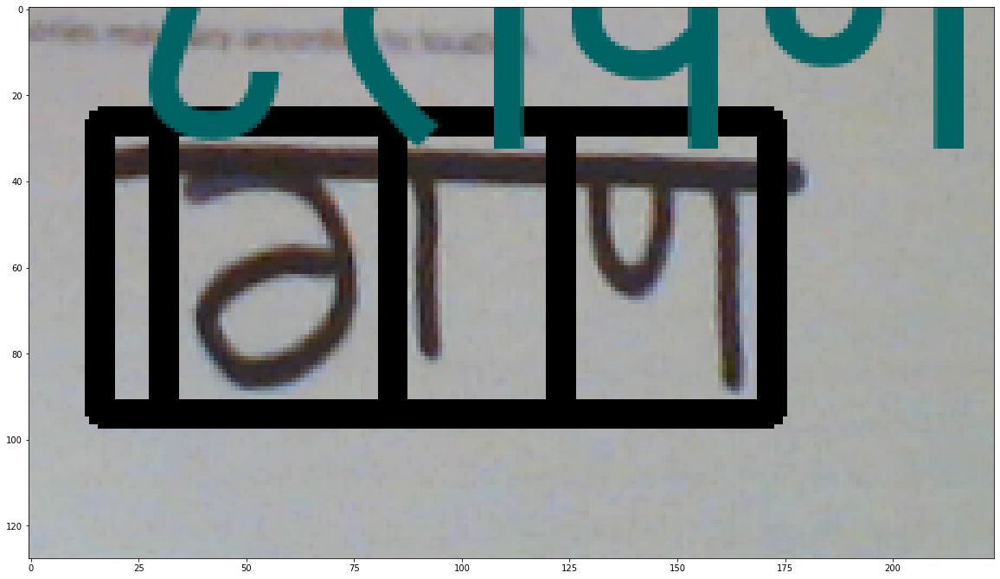

In 1.182995 sec


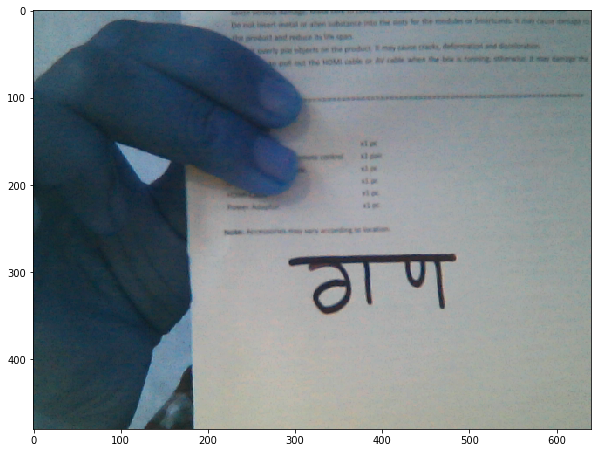

('तपप४', 81.37718290090561)


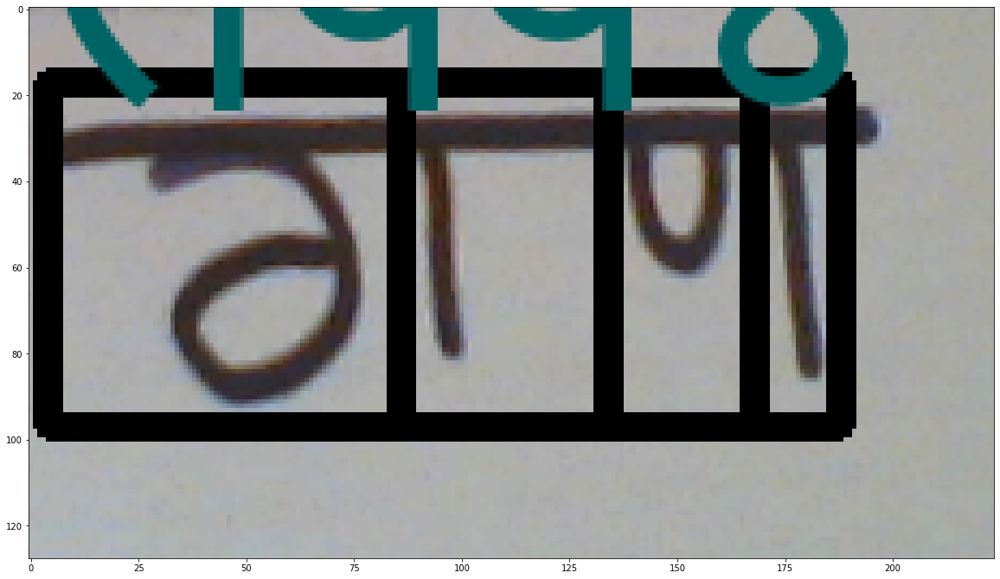

In 1.207016 sec


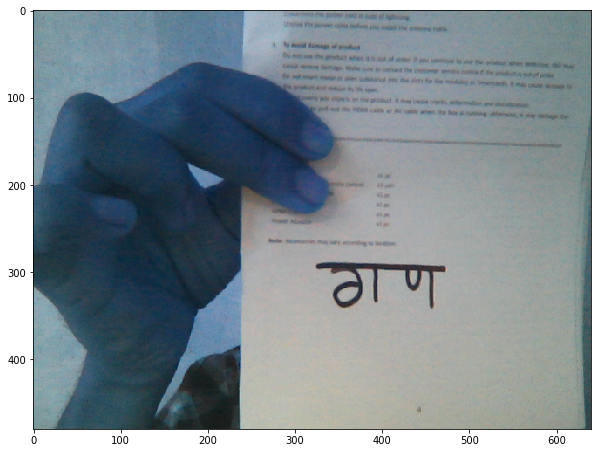

('८त८ण', 80.2314892411232)


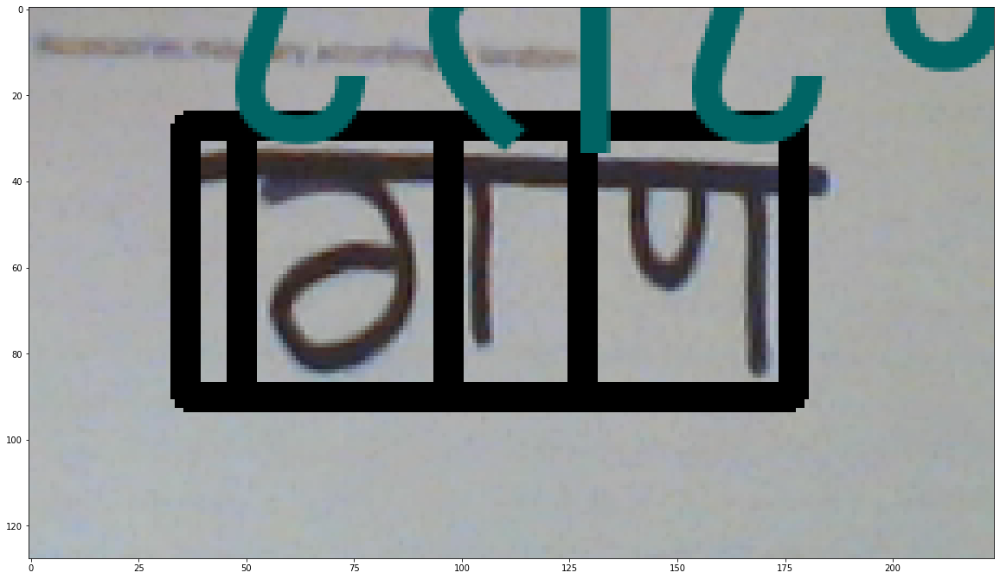

In 1.170000 sec


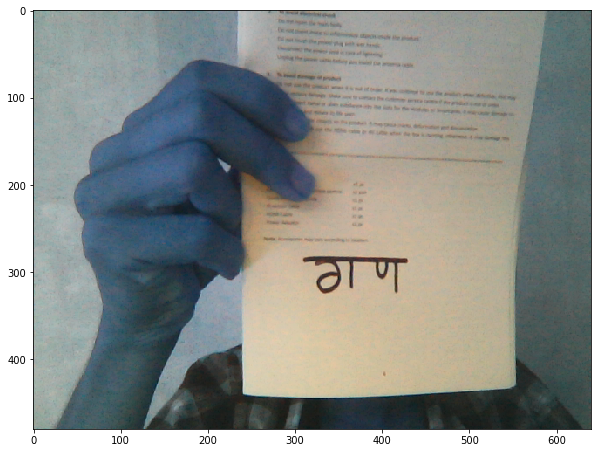

('८त८१४', 68.61744403839111)


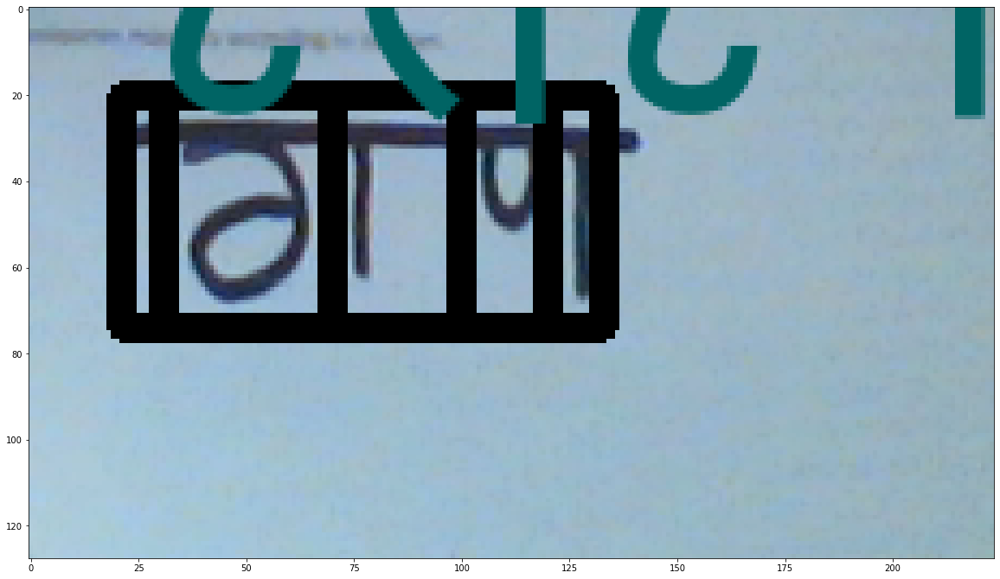

In 1.177021 sec


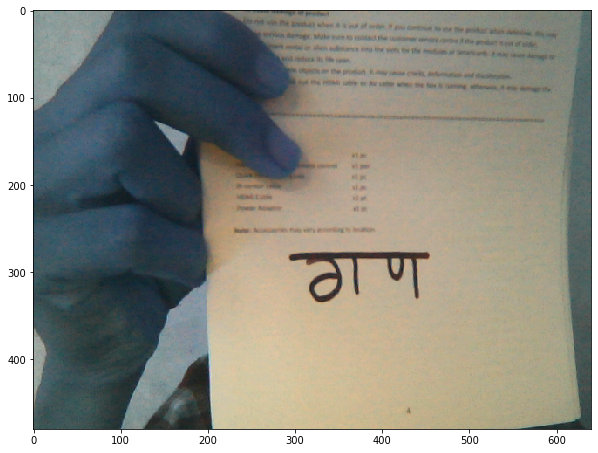

('८तपप४', 69.86095190048218)


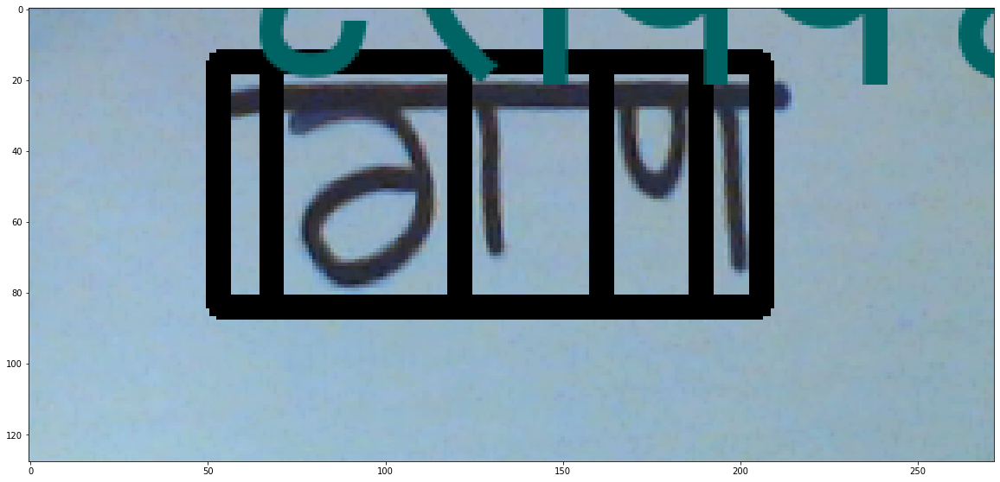

In 1.217995 sec


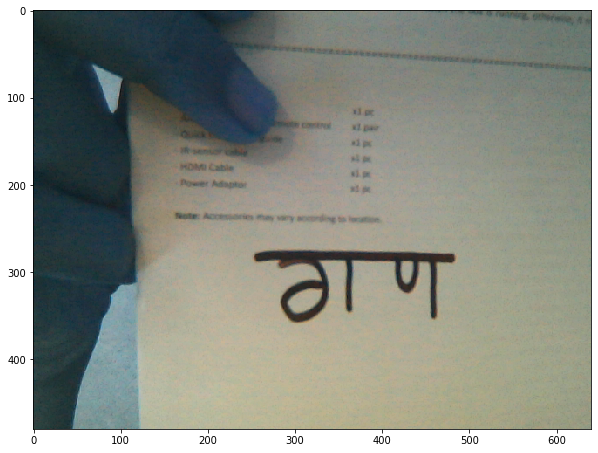

('८गप४८', 76.33164048194885)


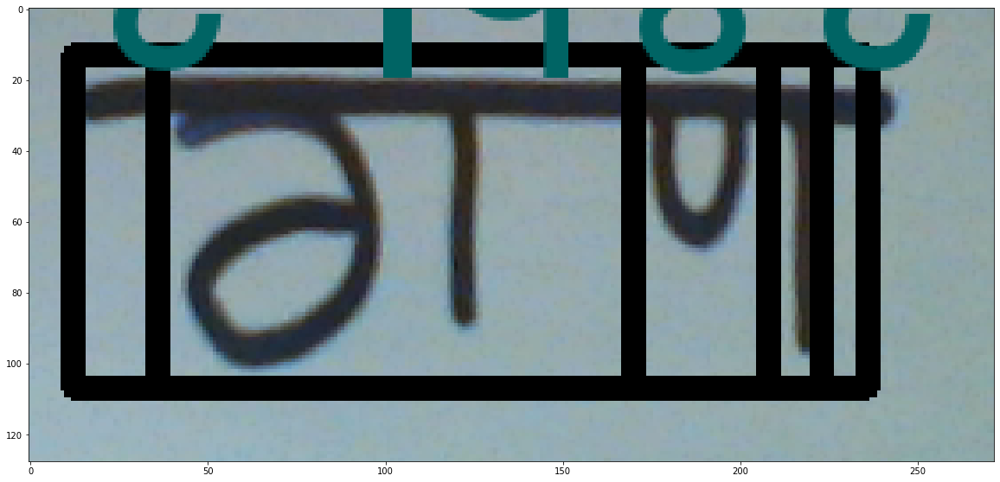

In 1.289016 sec


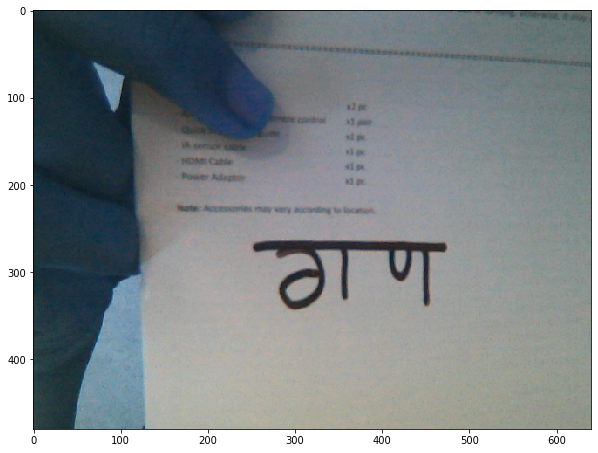

('८गप४', 79.40971851348877)


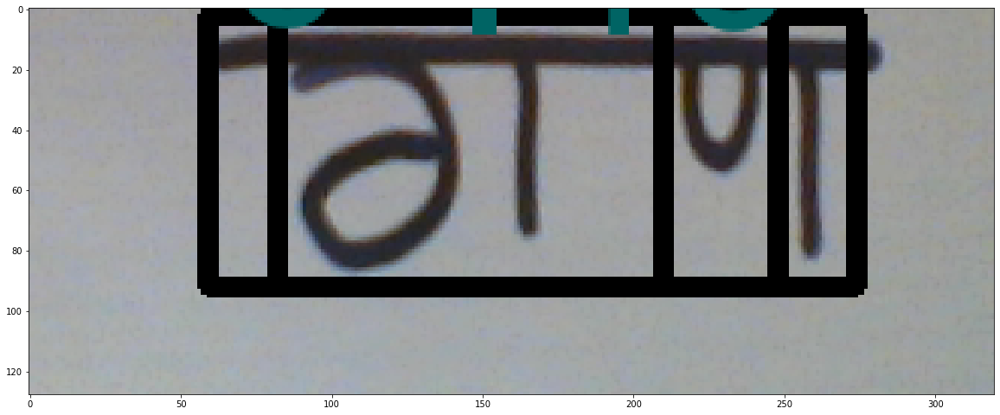

In 1.379001 sec


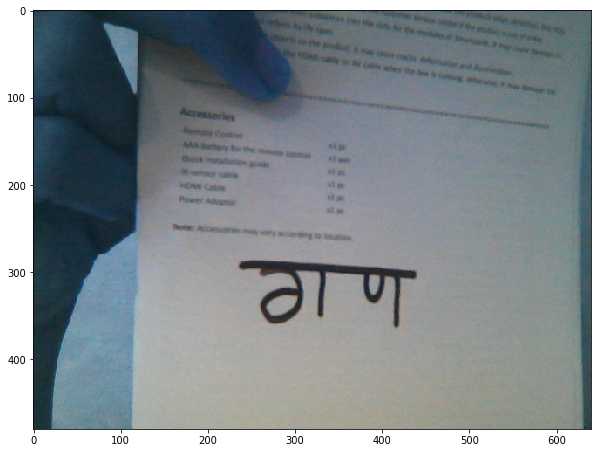

('८ठण', 84.74924166997273)


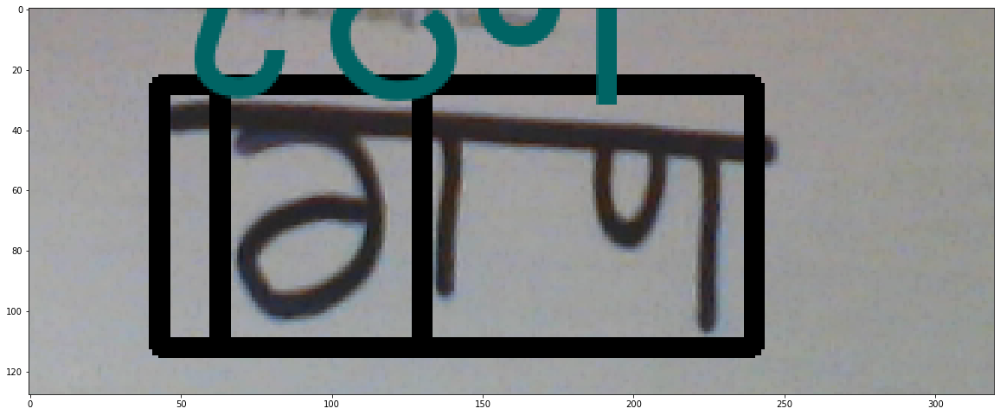

In 1.181012 sec


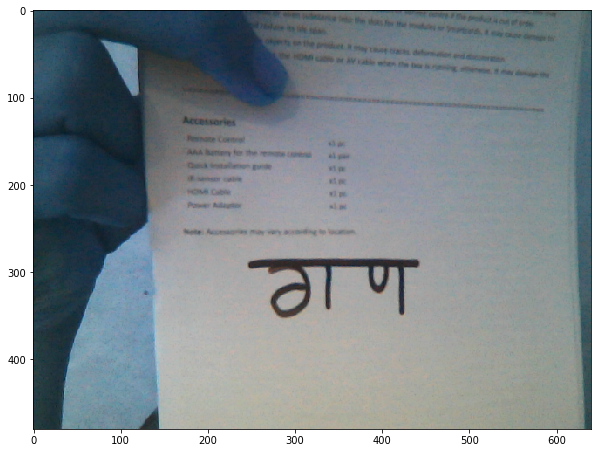

('८गग', 56.04723890622457)


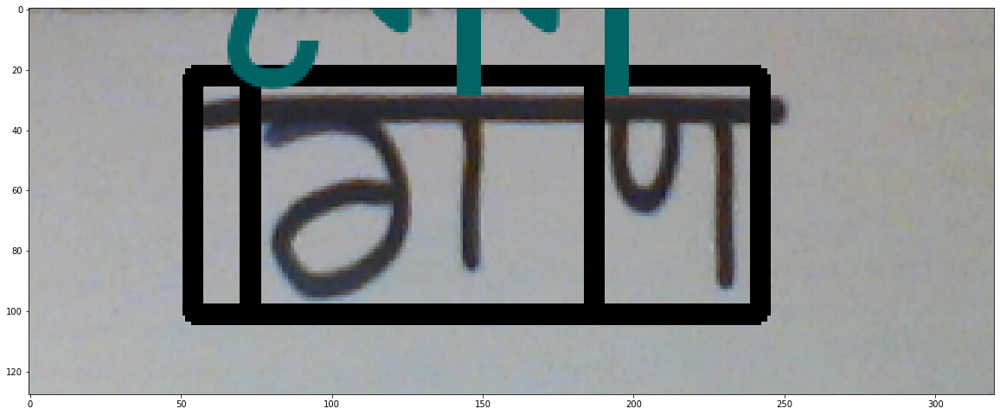

In 1.163994 sec


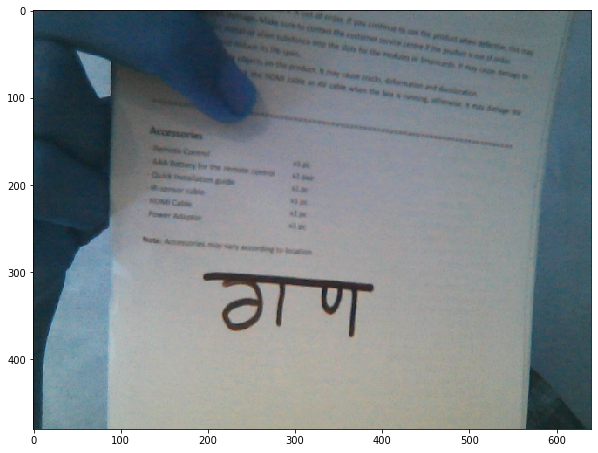

('८ठण', 84.45748090744019)


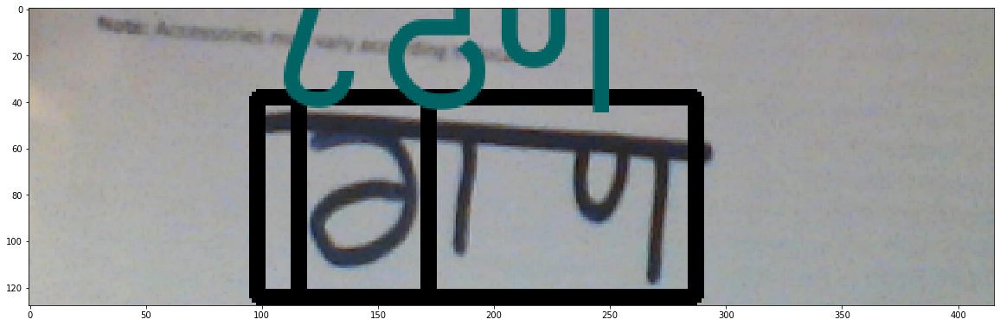

In 1.180996 sec


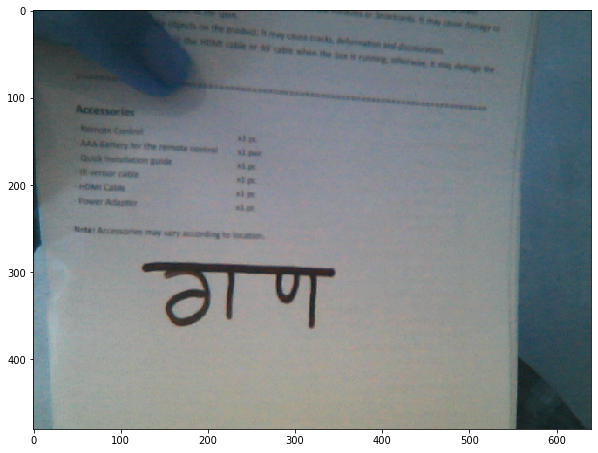

('८ठ८ण', 85.16612648963928)


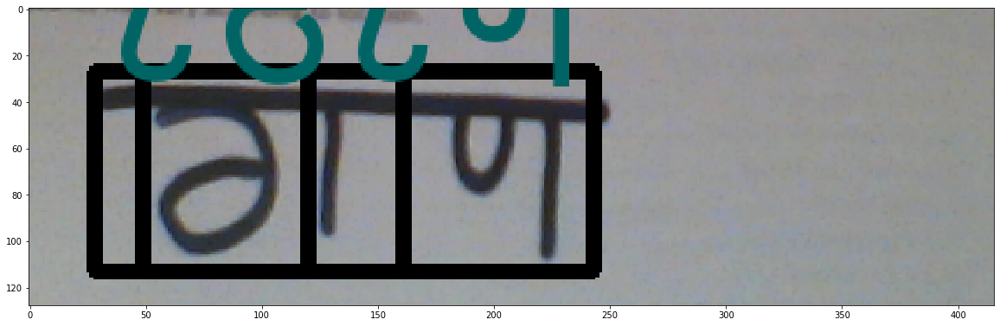

In 1.215004 sec


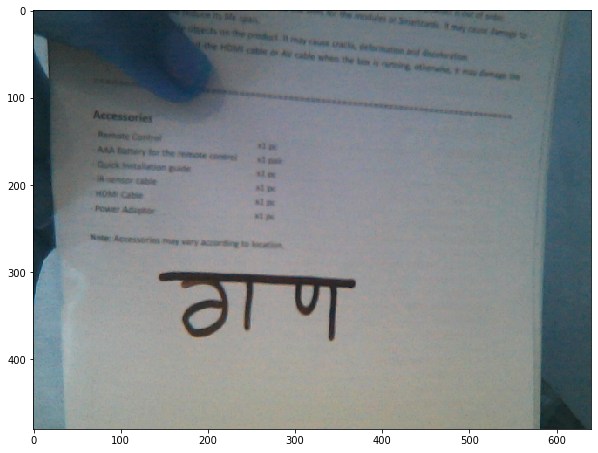

('८ठबण', 83.44622105360031)


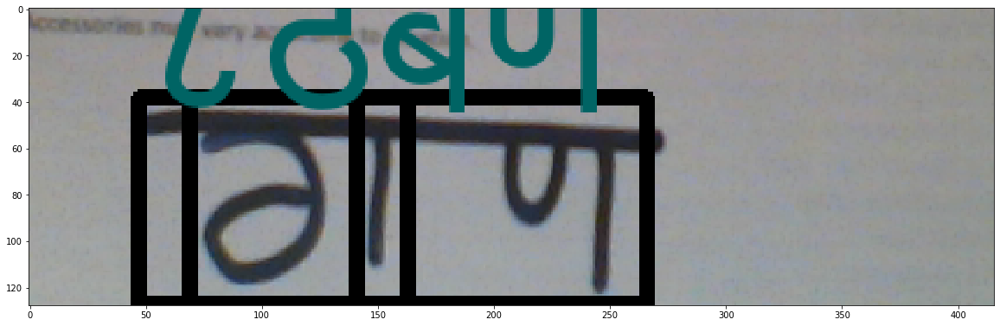

In 1.160996 sec


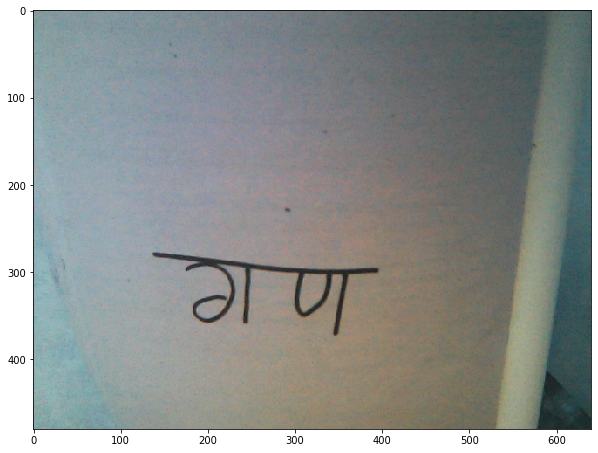

('म', 78.65211367607117)


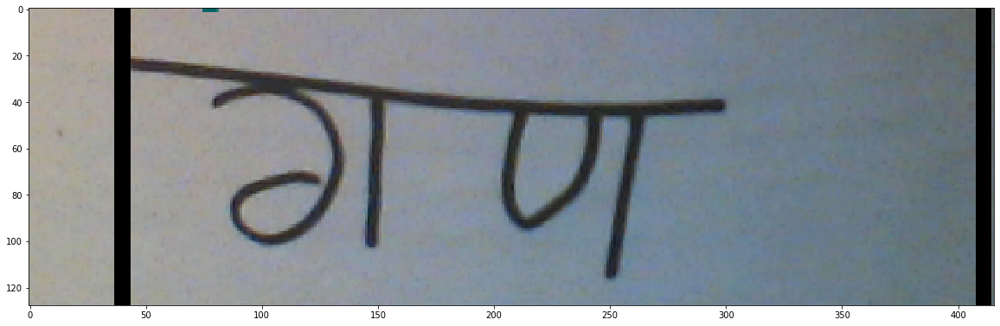

In 1.236003 sec


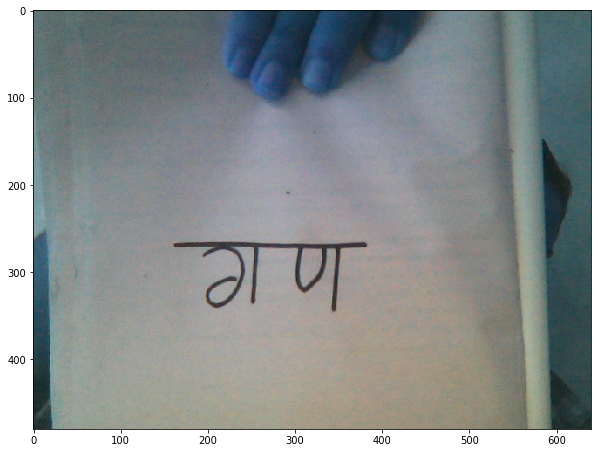

('८भप८', 86.16572916507721)


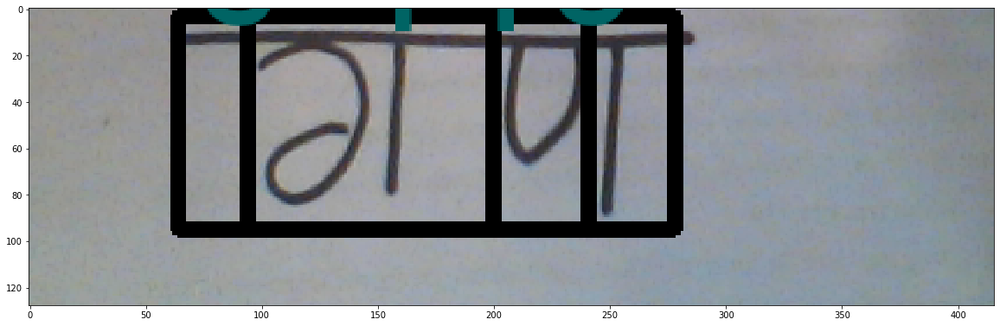

In 1.220888 sec


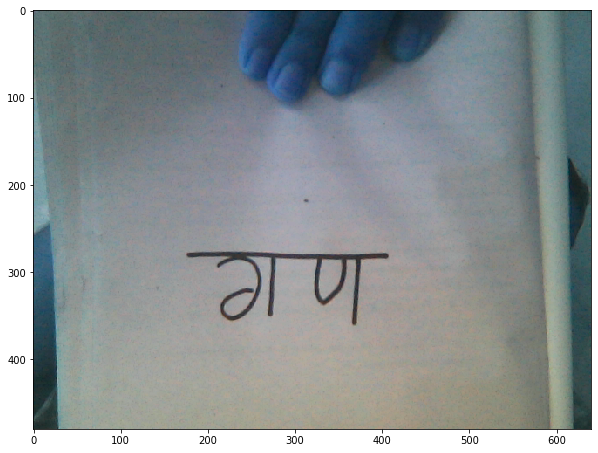

('८भग', 68.59088738759358)


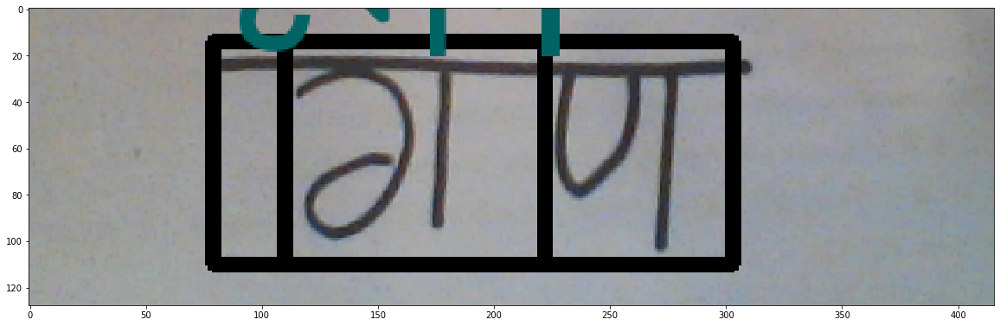

In 1.203996 sec


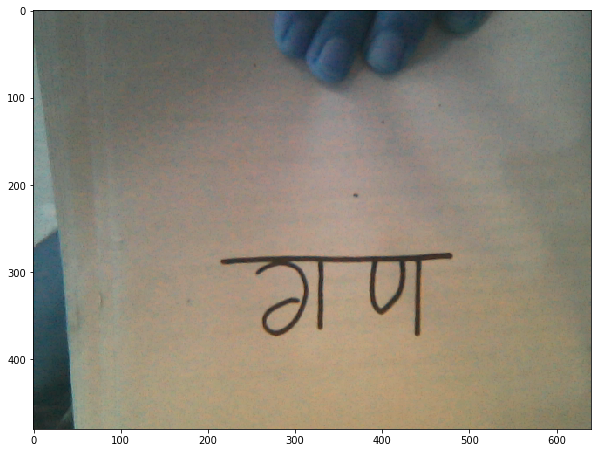

('८भण', 61.73080603281657)


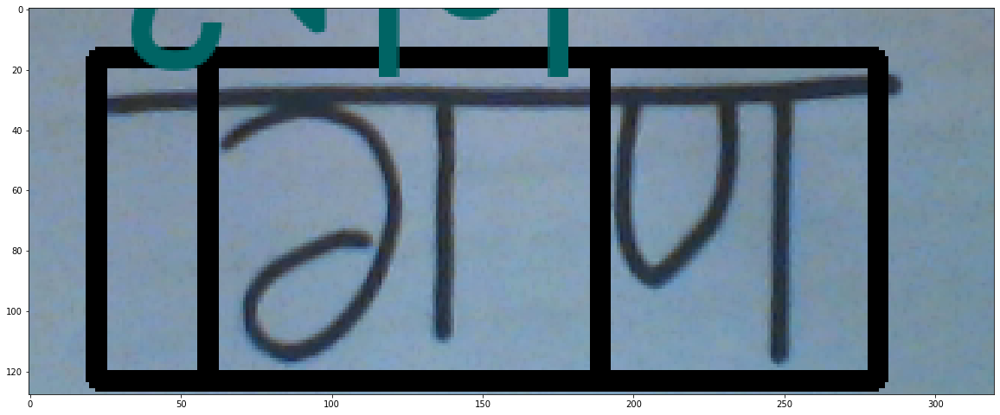

In 1.208917 sec


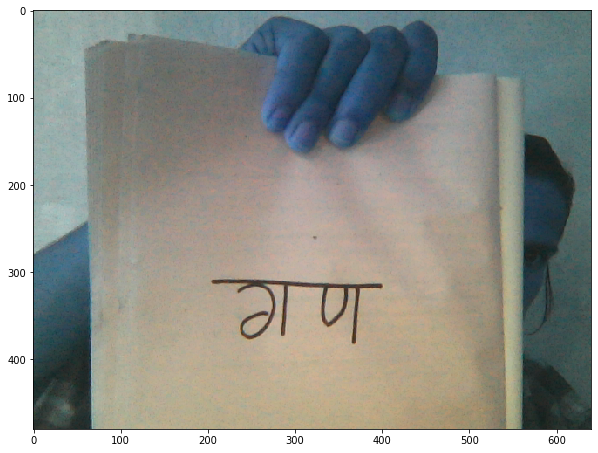

('८भण', 84.95080868403117)


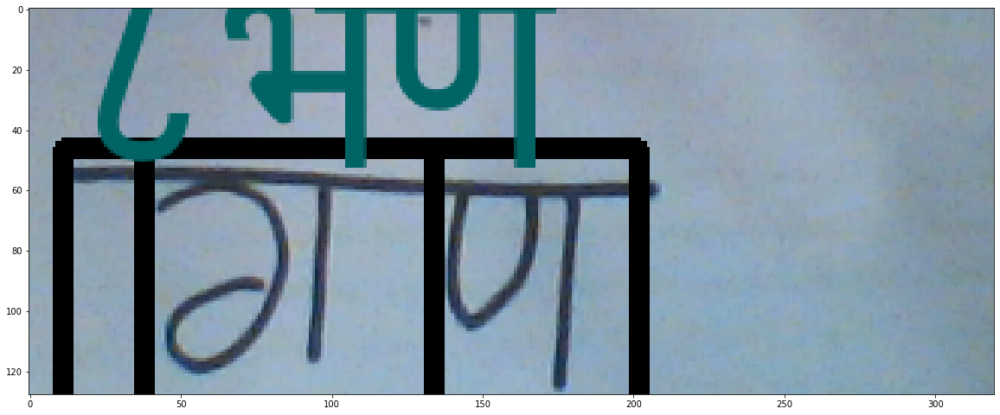

In 1.178022 sec


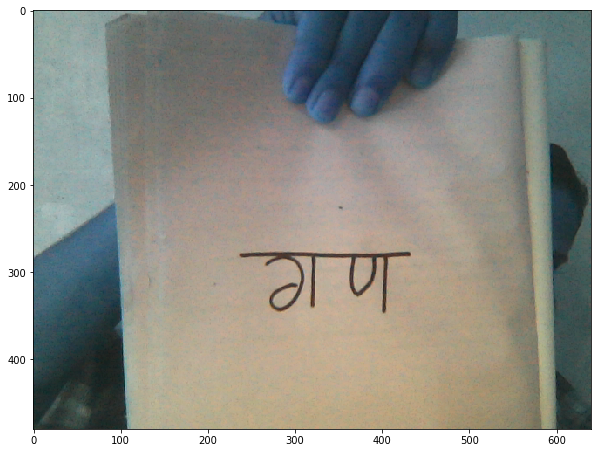

('८भण', 68.37771733601888)


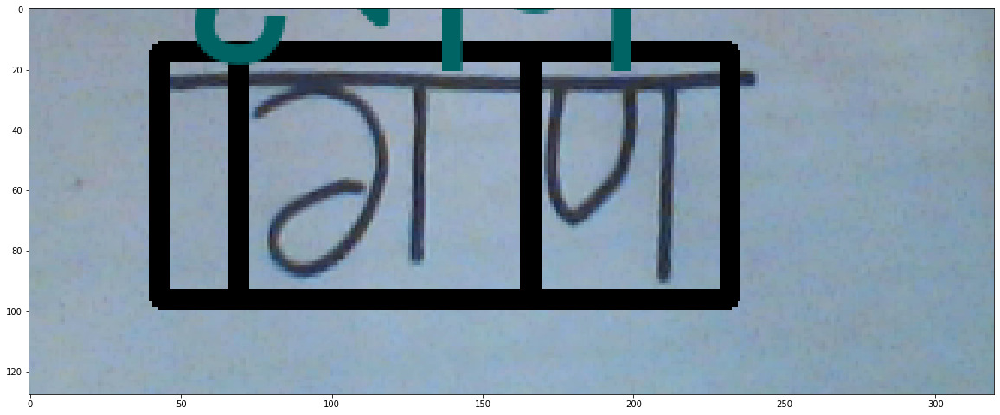

In 1.160995 sec


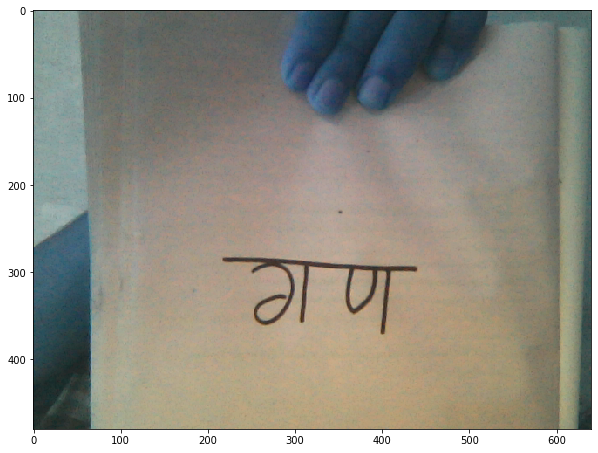

('८भण', 73.56066306432088)


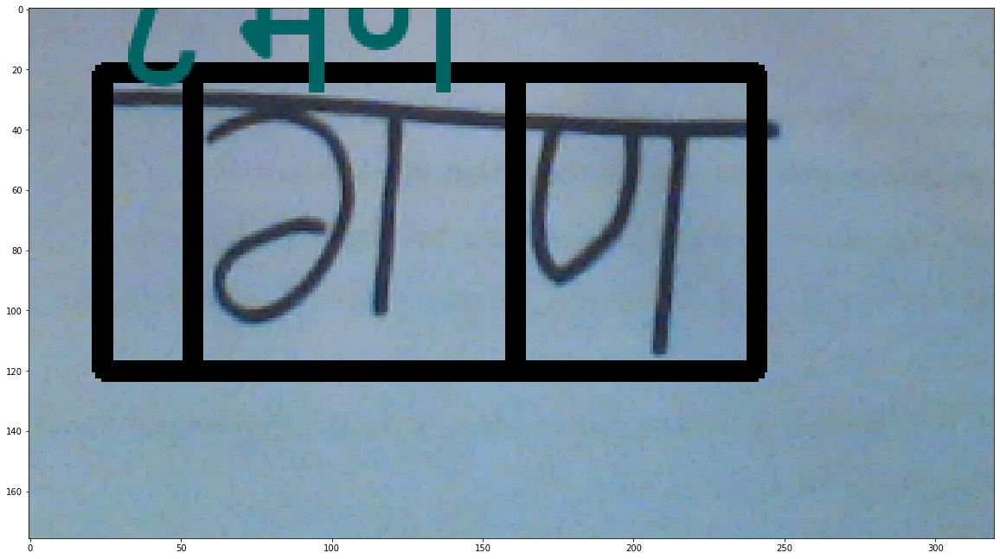

In 1.266995 sec


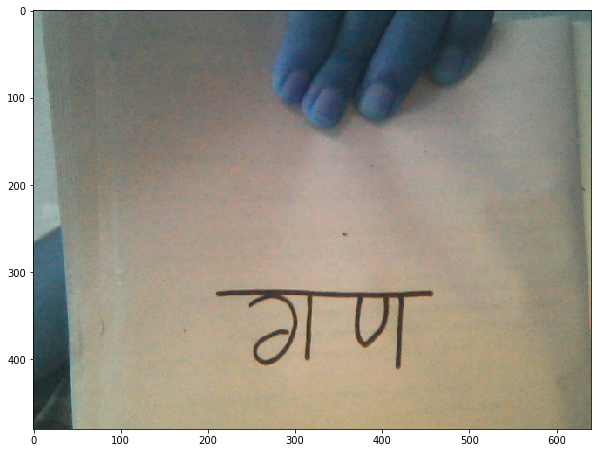

('८भण', 79.50946092605591)


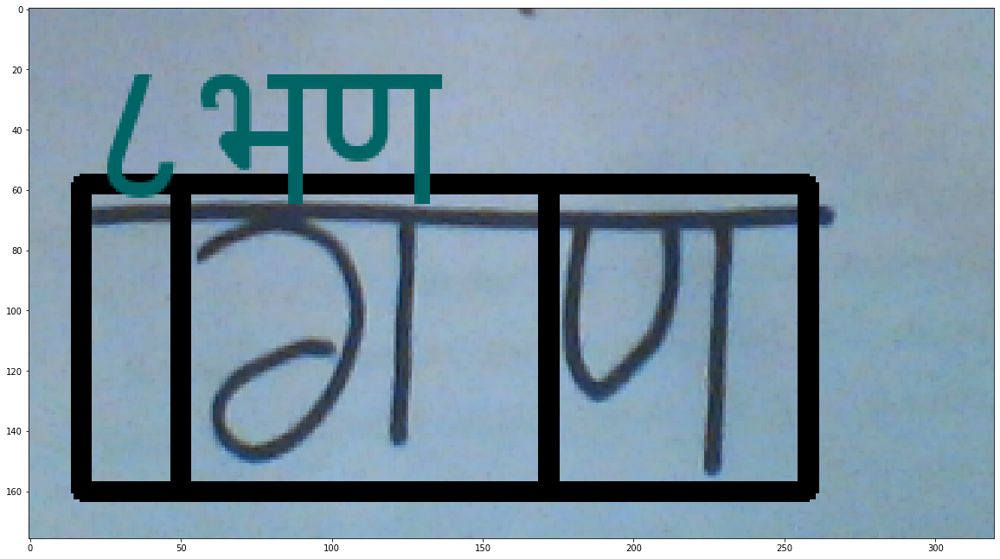

In 1.249993 sec


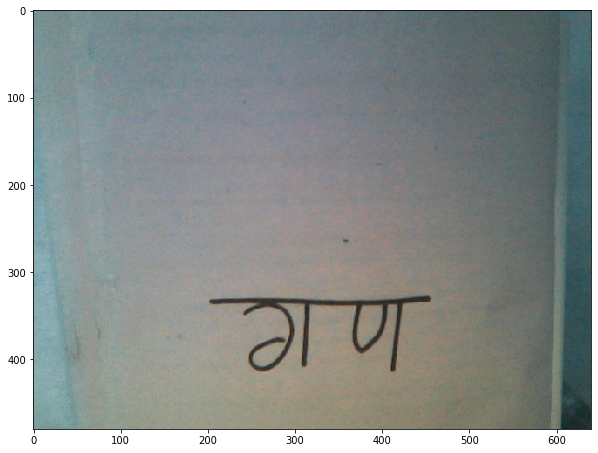

('८भप८', 83.41244161128998)


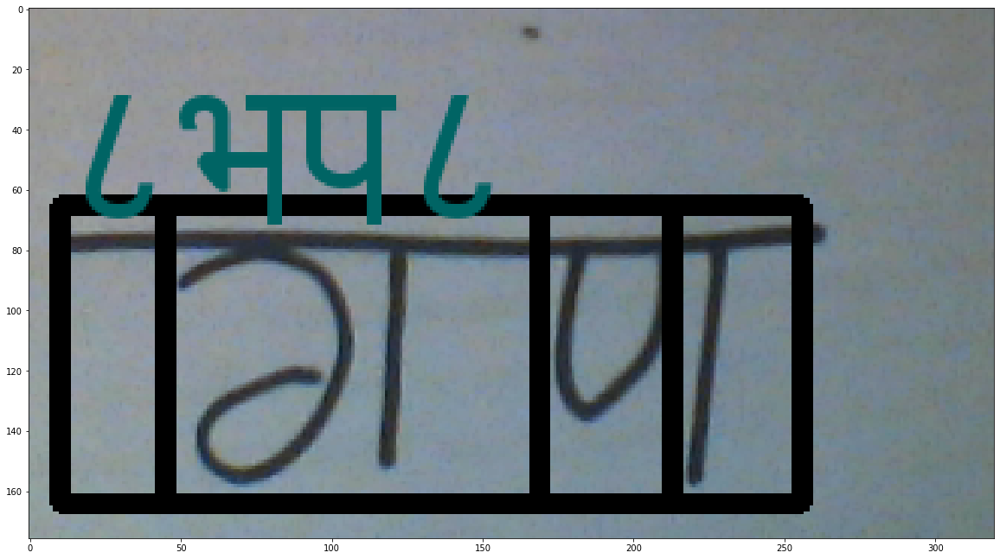

In 2.086021 sec


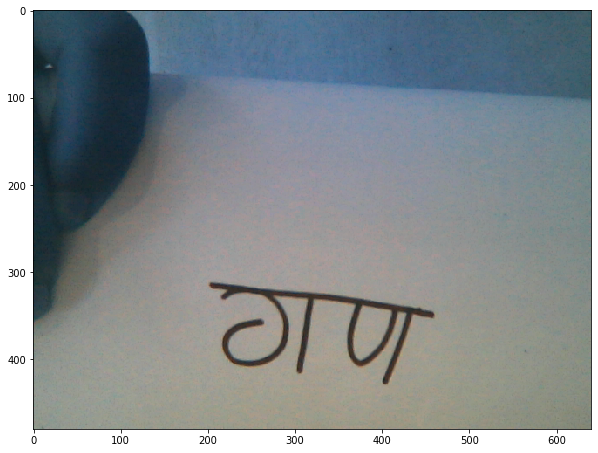

('८०ण', 85.1177712281545)


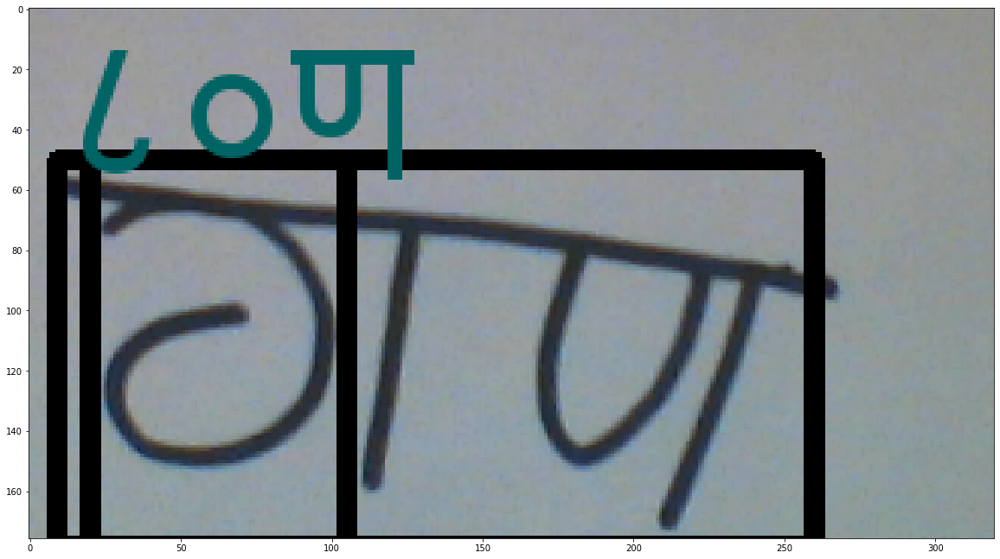

In 1.262016 sec


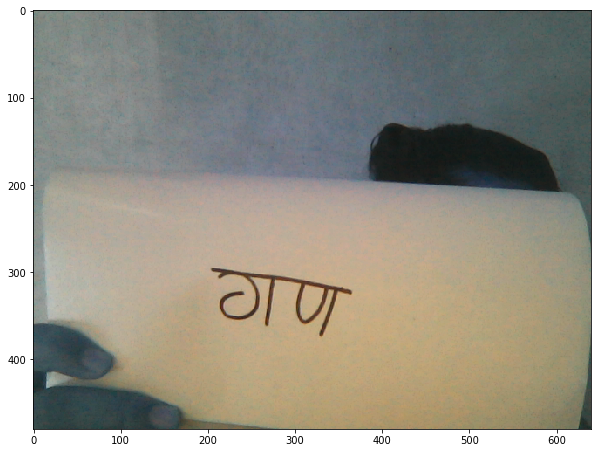

('०ण', 98.85374903678894)


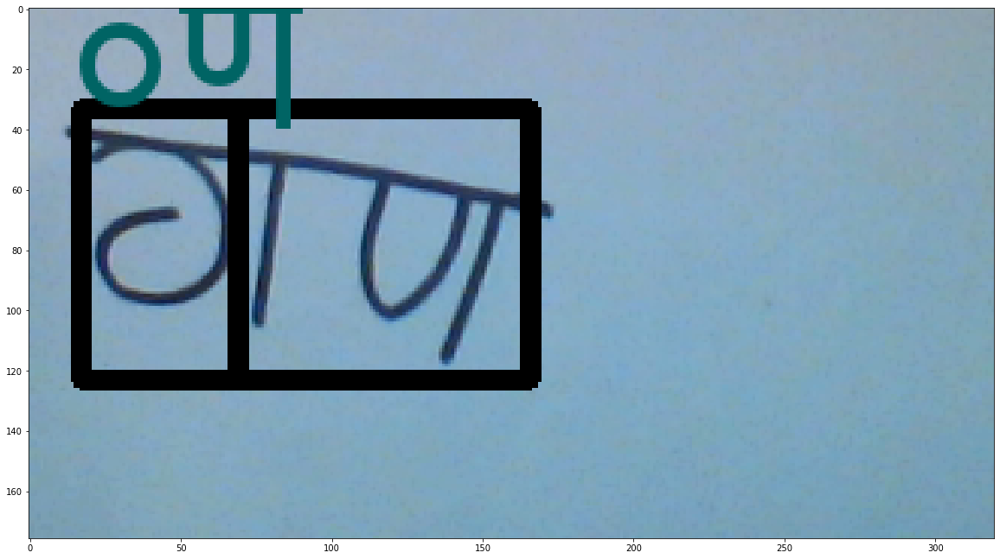

In 1.201029 sec


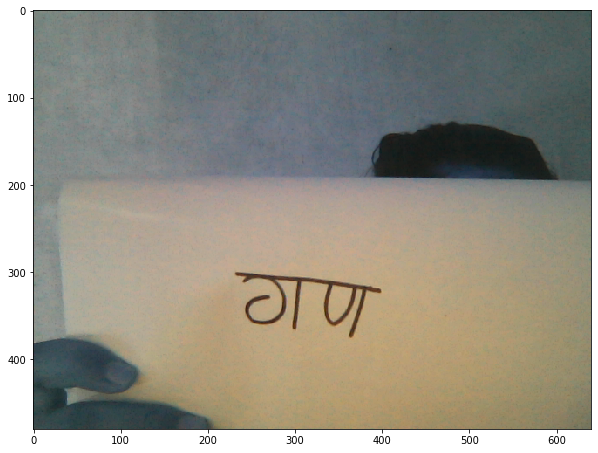

('०८ण', 99.32467540105183)


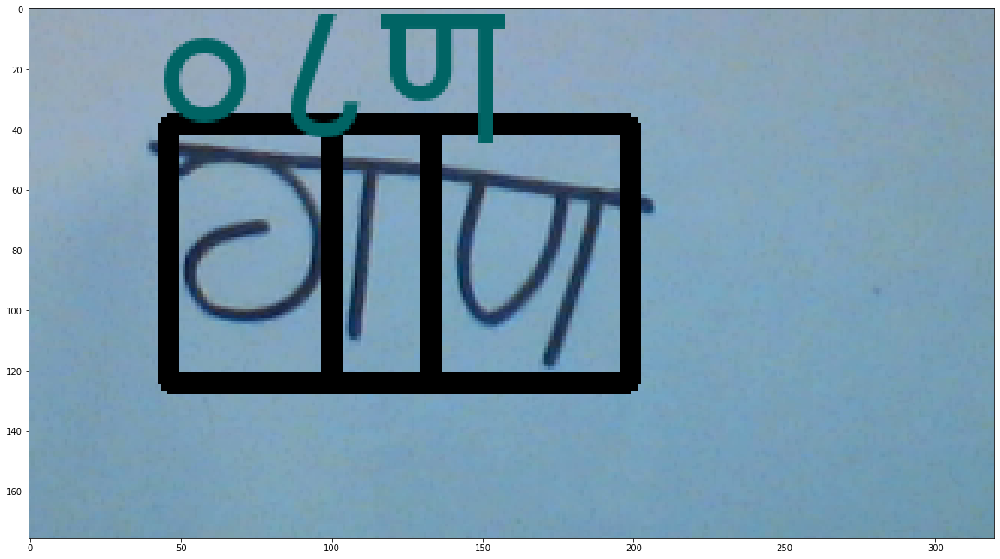

In 1.243023 sec


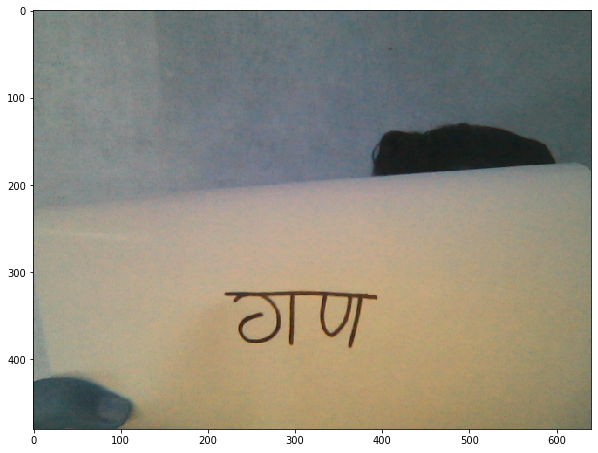

('चण', 71.88161015510559)


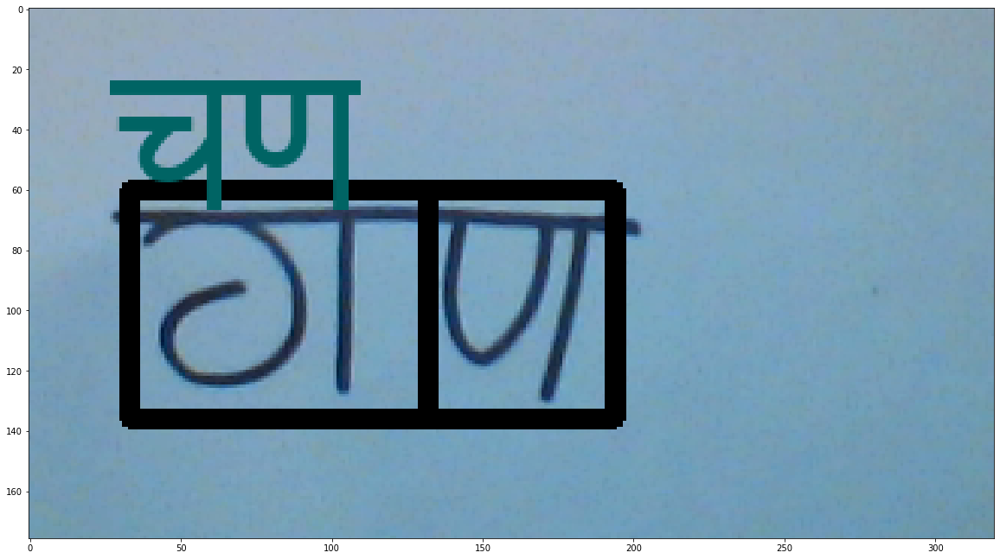

In 1.215996 sec


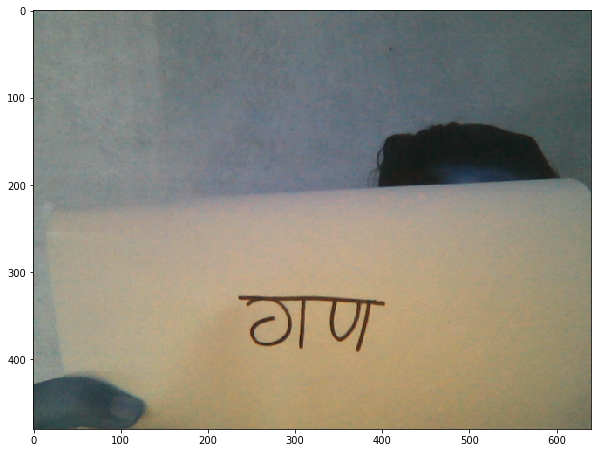

('८०८ण', 86.78783476352692)


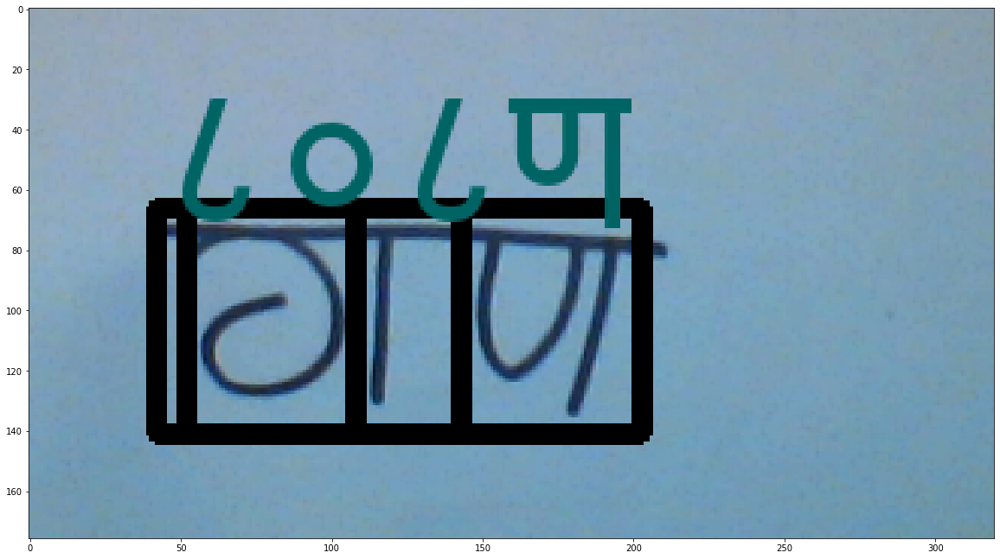

In 1.243993 sec


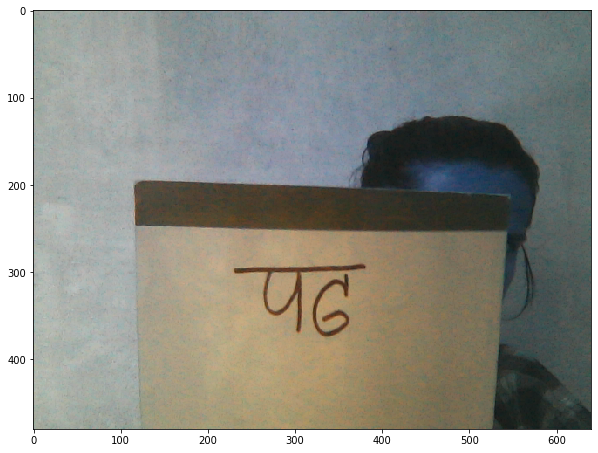

('१', 28.733018040657043)


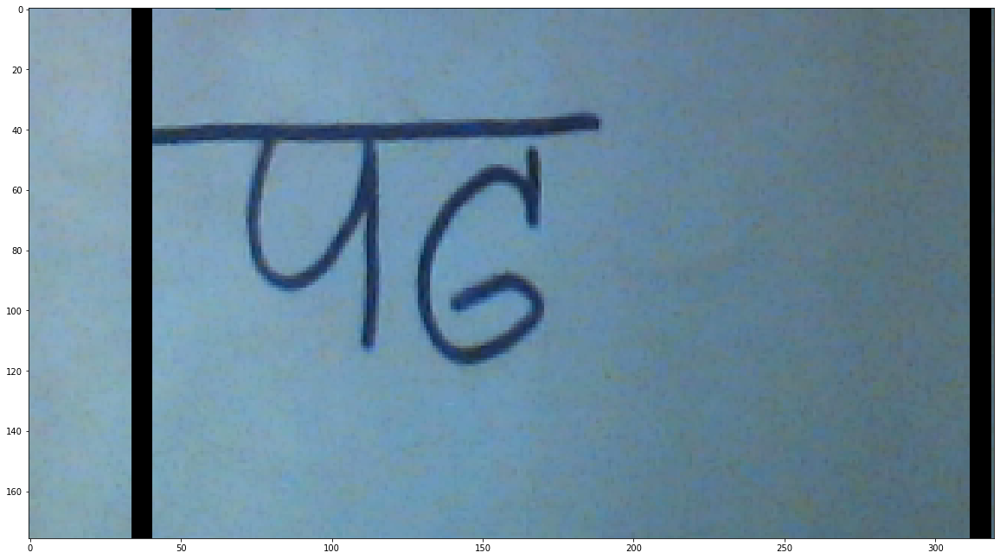

In 1.256004 sec


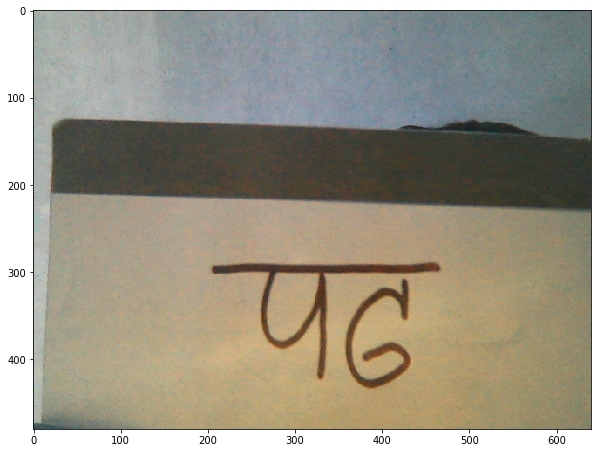

('८पढ', 76.78038080533345)


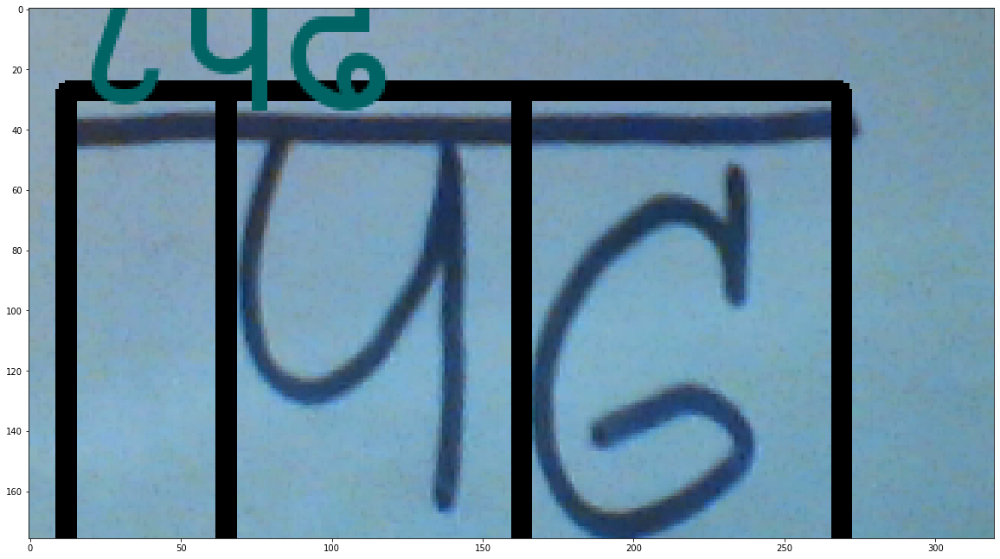

In 1.235008 sec


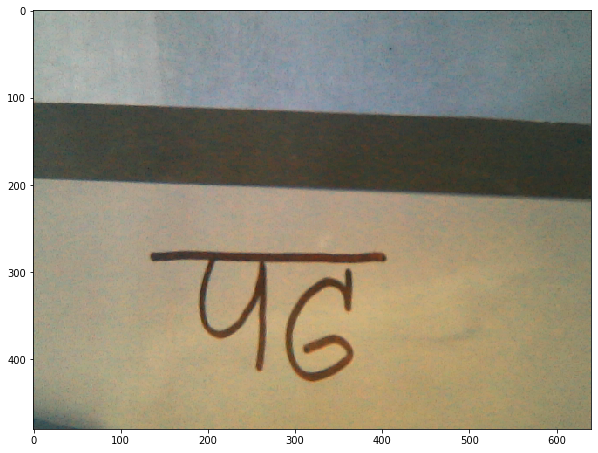

('णढ', 65.17795920372009)


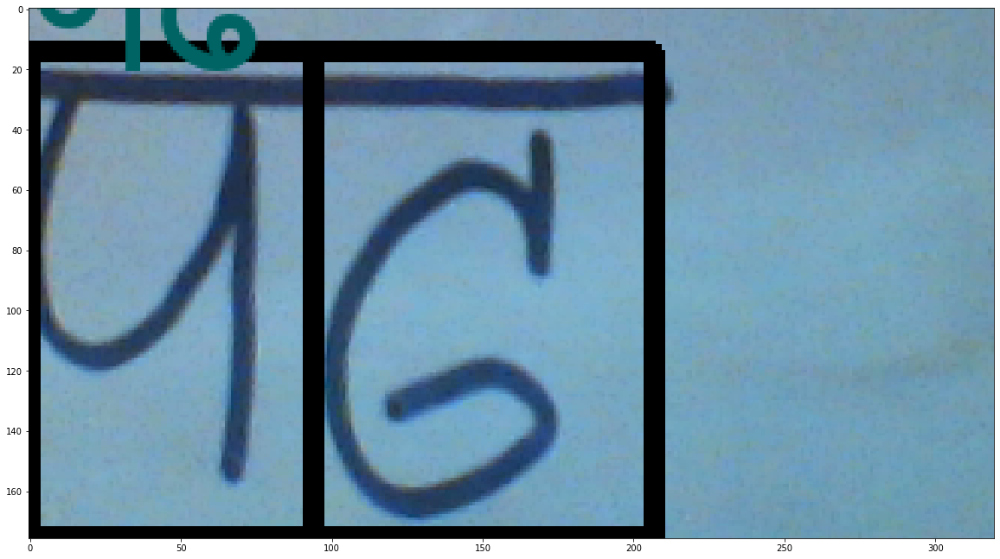

In 1.253009 sec


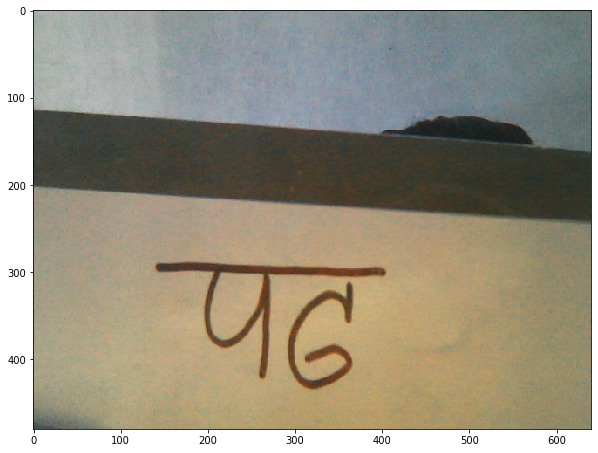

('पढ', 95.54637670516968)


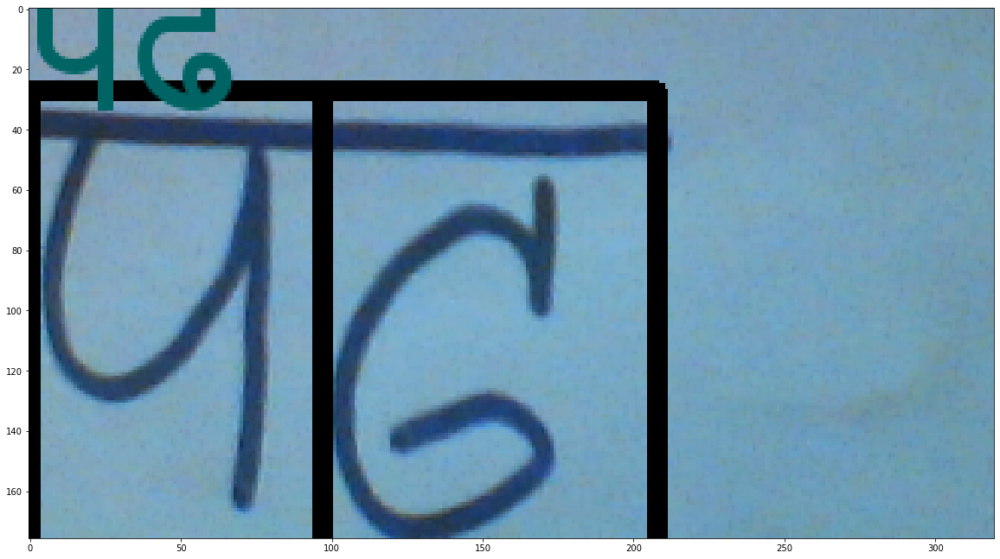

In 1.221022 sec


{(5, 98, 27, 215): 'झ',
 (5, 98, 215, 295): 'म',
 (31, 122, 52, 318): 'झ',
 (28, 115, 40, 291): 'झ',
 (13, 91, 74, 226): 'झ',
 (13, 91, 226, 293): 'म',
 (29, 107, 20, 237): 'झ',
 (28, 109, 46, 198): 'झ',
 (28, 109, 198, 263): 'म',
 (13, 87, 47, 137): 'क',
 (13, 87, 137, 216): 'ल',
 (13, 87, 216, 268): 'म',
 (20, 95, 40, 133): 'क',
 (20, 95, 133, 215): 'ल',
 (20, 95, 215, 269): 'म',
 (41, 120, 23, 113): 'क',
 (41, 120, 113, 191): 'ल',
 (41, 120, 191, 249): 'म',
 (17, 122, 39, 205): 'भ',
 (17, 122, 205, 274): 'ग',
 (39, 129, 9, 32): '८',
 (39, 129, 32, 170): 'ग',
 (39, 129, 170, 238): 'ग',
 (27, 109, 11, 31): '८',
 (27, 109, 31, 99): 'त',
 (27, 109, 99, 152): 'प',
 (27, 109, 152, 210): 'ग',
 (28, 109, 18, 38): '८',
 (28, 109, 38, 105): 'त',
 (28, 109, 105, 156): '८',
 (28, 109, 156, 216): 'ण',
 (26, 94, 16, 31): '८',
 (26, 94, 31, 84): 'त',
 (26, 94, 84, 123): 'प',
 (26, 94, 123, 172): 'ण',
 (17, 97, 4, 86): 'त',
 (17, 97, 86, 134): 'प',
 (17, 97, 134, 168): 'प',
 (17, 97, 168, 188): '४'

In [99]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import time
from tensorflow.keras.models import model_from_json
from tensorflow.keras.models import load_model
from PIL import ImageDraw, Image, ImageFont


class DHCOCR:
    def __init__(self, model_dir="cnn/", bthresh=0.092, min_seg=10, scheck=0.15):
        self.model_dir = model_dir
        self.bthresh = bthresh
        self.check_color=5
        self.min_seg=min_seg
        self.scheck=scheck
        #self.thresh=thresh
        self.model = None
        self.fontPath="gargi.ttf"
        self.segment_prediction={}
        
    def show(self, img, figsize=(20, 20)):
        fig = plt.figure(figsize=figsize)
        plt.imshow(img, cmap="gray")
        plt.show()
          
    def borders(self, here_img, thresh):
        shape = here_img.shape
        check= int(self.bthresh*shape[0])
        image = here_img[:]
        top, bottom = 0, shape[0] - 1
    

        #find the background color for empty column
        bg = np.repeat(thresh, shape[1])
        count = 0
        for row in range(1, shape[0]):
            if  (np.equal(bg, image[row]).any()) == True:
                #print(count)
                count += 1
            else:
                count = 0
            if count >= check:
                top = row - check
                break


        bg = np.repeat(thresh, shape[1])
        count = 0
        rows = np.arange(1, shape[0])
        #print(rows)
        for row in rows[::-1]:
            if  (np.equal(bg, image[row]).any()) == True:
                count += 1
            else:
                count = 0
            if count >= check:
                bottom = row + count
                break

        d1 = (top - 2) >= 0 
        d2 = (bottom + 2) < shape[0]
        d = d1 and d2
        if(d):
            b = 2
        else:
            b = 0

        return (top, bottom, b)

    def preprocess(self, img):
        bgr_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        blur = cv2.GaussianBlur(bgr_img,(5,5),0)
        ret,th_img = cv2.threshold(blur,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU) #converts black to white and inverse

        rows, cols = th_img.shape
        bg_test = np.array([th_img[i][i] for i in range(5)])
        if bg_test.all() == 0:
            text_color = 255
        else:
            text_color = 0
        self.bg_color=text_color
        tb = self.borders(th_img, text_color)
        lr = self.borders(th_img.T, text_color)
        dummy = int(np.average((tb[2], lr[2]))) + 2
        template = th_img[tb[0]+dummy:tb[1]-dummy, lr[0]+dummy:lr[1]-dummy]

        #plt.imshow(template)
        #plt.show()
        return (template, tb, lr)
    
    def segmentation(self, bordered):
        try:
            min_seg=self.min_seg
            scheck=self.scheck
            thresh=self.bg_color
            
            shape = bordered.shape
            check = int(scheck * shape[0])
            image = bordered[:]
            image = image[check:].T
            shape = image.shape
            #plt.imshow(image)
            #plt.show()

            #find the background color for empty column
            bg = np.repeat(255 - thresh, shape[1])
            bg_keys = []
            for row in range(1, shape[0]):
                if  (np.equal(bg, image[row]).all()):
                    bg_keys.append(row)            

            lenkeys = len(bg_keys)-1
            new_keys = [bg_keys[1], bg_keys[-1]]
            #print(lenkeys)
            for i in range(1, lenkeys):
                if (bg_keys[i+1] - bg_keys[i]) > check:
                    new_keys.append(bg_keys[i])
                    #print(i)

            new_keys = sorted(new_keys)
            #print(new_keys)
            segmented_templates = []
            first = 0
            bounding_boxes = []
            for key in new_keys[1:]:
                segment = bordered.T[first:key]
                if segment.shape[0]>=min_seg and segment.shape[1]>=min_seg:
                    segmented_templates.append(segment.T)
                    bounding_boxes.append((first, key))
                first = key

            last_segment = bordered.T[new_keys[-1]:]
            if last_segment.shape[0]>=min_seg and last_segment.shape[1]>=min_seg:
                segmented_templates.append(last_segment.T)
                bounding_boxes.append((new_keys[-1], new_keys[-1]+last_segment.shape[0]))

            #print(bounding_boxes)
            return(segmented_templates, bounding_boxes)
        except:
            return [[bordered], [(0, bordered.shape[1]-1)]]
    
    def localize(self, orig_img, tb, lr, segments):
        d=5
        rimg = orig_img.copy()
        boxes = []
        for simg, bb in zip(segments[0], segments[1]):
            bb = np.array(bb)
            bb += lr[0]
            # draw rows
            #rimg[tb[0]-d:tb[0], bb[0]-d:bb[1]+d] = 0
            #rimg[tb[1]:tb[1]+d, bb[0]-d:bb[1]+d] = 0

            # draw cols
            #rimg[tb[0]-d:tb[1]+d, bb[0]-d:bb[0]+d] = 0
            #rimg[tb[0]-d:tb[1]+d, bb[1]-d:bb[1]+d] = 0
            #print(tb, bb)
            boxes.append((tb[0]-d, tb[1]+d, bb[0], bb[1]))
            #show(rimg)
        rimg = self.img.copy()
        for box in boxes:
            t, b, l, r = box
            cv2.rectangle(rimg, (l, t), (r, b), (255-self.bg_color, 255-self.bg_color, 255-self.bg_color), d)
        #show(rimg)    
        self.boxes=boxes
        return rimg, boxes

    def prediction(self, img):
        # load json and create model
        if self.model is None:
            json_file = open('cnn\cnn.json', 'r')

            loaded_model_json = json_file.read()
            json_file.close()
            loaded_model = model_from_json(loaded_model_json)

            # load weights into new model
            loaded_model.load_weights("cnn\cnn.h5")
            #print("Loaded model from disk")

            loaded_model.save('cnn.hdf5')
            loaded_model=load_model('cnn.hdf5')
            self.model = loaded_model
            characters = '०,१,२,३,४,५,६,७,८,९,क,ख,ग,घ,ङ,च,छ,ज,झ,ञ,ट,ठ,ड,ढ,ण,त,थ,द,ध,न,प,फ,ब,भ,म,य,र,ल,व,श,ष,स,ह,क्ष,त्र,ज्ञ'
            self.characters = characters.split(',')

        else:
            loaded_model=self.model
            #characters = self.characters
        
        x = np.asarray(img, dtype = np.float32).reshape(1, 32, 32, 1) / 255 

        output = loaded_model.predict(x)
        output = output.reshape(46)
        predicted = np.argmax(output)
        devanagari_label = self.characters[predicted]
        success = output[predicted] * 100

        return devanagari_label, success
    
    def write_character(self, img, pos, txt, fsize=5, fcolor=(0, 100, 100, 0)):
        img = Image.fromarray(img)
        draw = ImageDraw.Draw(img)
        font = ImageFont.truetype(self.fontPath, fsize)
        draw.text(xy=pos, text=txt, font=font, fill=fcolor)
        
        return np.array(img)
        
    def classifier(self, segments):
        pred_lbl = ""
        acc = []
        
        #print(len(segments))
        for i, segment in enumerate(segments[0]):
            if self.bg_color==0:
                segment=255-segment
                #self.show(segment)
            segment = cv2.resize(segment, (32, 32))
            segment = cv2.GaussianBlur(segment, (3, 3), 0)
            segment = cv2.erode(segment, (3, 3), 1)
            #show(segment)
            lbl, a = self.prediction(segment)
            self.segment_prediction[self.boxes[i]] = lbl
            
            pred_lbl+=lbl
            acc.append(a)
        return pred_lbl, np.array(acc).mean()

    def easy_flow(self, img, view="image"):
        prepimg, tb, lr = self.preprocess(img)
        segments=self.segmentation(prepimg)
        #print(segments[1])
        localized = self.localize(img, tb, lr, segments)
        op = self.classifier(segments)
        
        print(op)
        if view=="image":
            d = int(100*500/localized[0].shape[0])
            limg = self.write_character(localized[0], pos=(lr[1], tb[0]-d), txt=op[0], fsize=d)            
            self.show(img=limg)
        elif view=="frame":
            d = int(30*400/localized[0].shape[0])
            #print(d)
            limg = self.write_character(localized[0], pos=(lr[0], tb[0]-d), txt=op[0], fsize=d)
            self.show(img=limg)
            #print(limg.shape)
            cv2.imshow("Detection", limg)
        
    def camera(self, flag):
        choice = print("Click spacebar for photo and anything else for video.\n")
        orig = 1
        cap = cv2.VideoCapture(0)
        tr = 0.1
        br = 0.8
        lc = 0.1
        rc = 0.8
        f = 0

        while(flag):    
            ret, frame = cap.read()
            if ret:
                self.img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
                #frame = cv2.flip(frame, 1)
                #key event
                s = cv2.waitKey(2) & 0xFF

                if(chr(s) == 'x'):
                    f = -1
                if(chr(s) == 'z'):
                    f = 1

                if(chr(s) == 'a'):
                    tr = tr + 0.1 * f
                if(chr(s) == 'd'):
                    br = br + 0.1 * f
                if (chr(s) == 's'):
                    lc = lc + 0.1 * f
                if (chr(s) == 'w'):
                    rc = rc + 0.1 * f


                s_x, s_y = np.shape(frame)[0] * tr, np.shape(frame)[1] * lc
                e_x, e_y = np.shape(frame)[1] * br, np.shape(frame)[0] * rc
                s_x, s_y = np.int32(s_x), np.int32(s_y)
                e_x, e_y = np.int32(e_x), np.int32(e_y)

                gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
                ogray = gray[:]
                gray = gray[s_y:e_y, s_x:e_x]
                self.img = self.img[s_y:e_y, s_x:e_x]
                #original = frame[s_y:e_y, s_x:e_x]

                if (s == 32): #space to capture image and do recognition
                    time1 = time.time()
                    self.show(frame, (10, 10))
                    self.easy_flow(self.img, "frame")
                    print("In %f" %(time.time()-time1), 'sec')
                if (s == 13): #enter to do realtime recognition
                    orig = 0
                    #cv2.destroyWindow('Project DCR')
                    print("Doing RT...")
                    self.easy_flow(self.img, "frame")


                else:
                    if(orig != 0):
                        show = frame[:]
                        text = "Press 'space' to take a photo and 'enter' to do realtime(slow)."
                        text1 = "Make sure the character is inside rectangle."
                        text2 = "a/s/d/w for change rectangle and z/x for inc/dec."
                        cv2.putText(show, text1, (15, 50), cv2.FONT_HERSHEY_COMPLEX, 0.75, (0, 100, 200))
                        cv2.putText(show, text2, (0, np.shape(frame)[0] - 10), cv2.FONT_HERSHEY_COMPLEX, 0.65, (50, 20, 255))
                        cv2.rectangle(show, (s_x, s_y), (e_x, e_y), (0, 255, 0), 2)
                        cv2.putText(show, text, (15, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (15, 0, 255), lineType=cv2.LINE_AA) 
                        cv2.imshow('Project DCR', show)

            else:
                print('Trying.....\n')
                continue


            if s == 27:
                break
        cap.release()
        cv2.destroyAllWindows()
    
    def main(self, img=None):
        if img is None:
            # go to Camera mode
            self.use_camera(True)
        else:
            try:
                img = cv2.imread(img, 1)
                self.img=img
                #self.show(img)
                time1 = time.time()
                
                self.easy_flow(img)
                
                print("In %f" %(time.time()-time1), 'sec')
            except:
                print("Image not found now turning to video mode.\n")
                try:
                    self.camera(True)
                except:
                    print('Something is wrong. Try with more stable, less noise and clear picture.\n')
                #cap.release()
                cv2.destroyAllWindows()
docr = DHCOCR()
docr.main(img="Assets/maganaa.png")
docr.segment_prediction
# prepimg, tb, lr = docr.preprocess(img)

# segments=docr.segmentation(prepimg)
# # for simg in segments[0]:
# #     plt.imshow(simg)
# #     plt.show()
# localized = docr.localize(img, tb, lr, segments)
# docr.classifier(segments[0])

### Method: `show`
This is simple method made with `matplotlib` to visualise our image on bit larger figure.

### Method: `main`
A method that is called by object and this method performs detection on image if image path is valid. And if image path is not valid then the camera is turned on. This method depends on `easy_flow` method.

### Method: `camera`
A method to do entire camera work.
**Notes:**
* Keys a/s/d/w are used to move rectangle on left/right/down/top respectively. And keys z/x are used to tune movement of a/s/d/w on +ve or -ve direction.
* Key `space` is used for taking the image inside ROI and then pass it to further methods to perform detection.
* Key Enter is used to do realtime detection but this is not fast and valid at this time.
* Key Escape to exit from the camera mode.

### Method: `easy_flow`
A method to do entire tasks. This method is to help `main` method.
* Call method `preprocess` by passing original image and take cropped image, top/bottom and left/right values of text on image.
* Call method `segmentation` by passing cropped image and take segments. 
* Call method `localize` by passing segments and take a localized image.
* Call method `classifier` by passing segments.
* Call method `write_character` by passing localized image, position, predicted label, font size.
* Call method `show` to view the final image.

### Method: `preprocess`
A method to do preprocessing tasks like image cropping, background color finding. Please follow the section above to see how this method uses `border` method to crop an image.

### Method: `segmentation`
Please follow the demo given earlier for simple explanation. But the method used above is modified, more imporved. Let me know if ther are any problems.

### Method: `localize`
Instead of using template matching and drawing a rectangle around a matched region, we are using the bounding box approach. Take a segmenting columns from above method and then use that to find the boxes, then draw it. Easy.

### Method: `classifier`
This method takes segments as input and resizes the segment, adds some blur and passes it to classifer. A method `prediction` prepares the classification model and returns the label, accuracy of segment's prediciton.
 

### Method: `write_character`
A method which writes the character predicted by our model on the image. **Devanagari** is not supported by OpenCV hence we have to use PIL also we used font.

## Finally
We have created a simple OCR for Devanagari using NumPy, Keras, OpenCV. Currently this is only running on OpenCV window and python program. Making it web runnable will be my next task.
The demo of current system looks like below.

<figure>
<video src = "Assets/dcr.mp4" width="100%" controls autoplay loop> </video>
<figcaption style = "text-align:left; font-style:italic">DCR Demo</figcaption>
</figure> 

## What next?
I am always looking for feedback and i hope everyone finds this project useful. If you have any doubt or problem regarding this project then you can find me on LinkedIn as [Ramkrishna Acharya](https://www.linkedin.com/in/qramkrishna). For next step of this project, i will implement this project on Web APP using flask. In the mean time i recommend you to view some of my works.